In [1]:
%matplotlib inline 
from matplotlib import pyplot as plt
import pandas as pd

In [2]:
order = pd.read_csv(r'C:\Users\chenhur\Documents\GitHub\Showa_CsxPython\Ntu_DataSet\Ntu_Orders.csv')
ecoupon =pd.read_csv(r'C:\Users\chenhur\Documents\GitHub\Showa_CsxPython\Ntu_DataSet\NTU_1317_Ecoupon.txt',sep='\t') 
member = pd.read_csv(r'C:\Users\chenhur\Documents\GitHub\Showa_CsxPython\Ntu_DataSet\NTU_1317_Member.txt',sep='\t',low_memory=False) 
promotion =  pd.read_csv(r'C:\Users\chenhur\Documents\GitHub\Showa_CsxPython\Ntu_DataSet\NTU_1317_Promotion.txt',sep='\t')  
promotionorders =pd.read_csv(r'C:\Users\chenhur\Documents\GitHub\Showa_CsxPython\Ntu_DataSet\NTU_1317_PromotionOrders.txt',sep='\t',low_memory=False) 

In [3]:
order = order.rename(columns=lambda x: x.replace('\ufeff', ''))
ecoupon = ecoupon.rename(columns=lambda x: x.replace('\ufeff', ''))
member = member.rename(columns=lambda x: x.replace('\ufeff', ''))
promotion = promotion.rename(columns=lambda x: x.replace('\ufeff', ''))
promotionorders = promotionorders.rename(columns=lambda x: x.replace('\ufeff', ''))

In [4]:
PromotionConditions =pd.read_csv(r'C:\Users\chenhur\Documents\GitHub\Showa_CsxPython\Ntu_DataSet\PromotionConditions.csv')  

In [11]:
PromotionConditions.head(7)

,PromotionId,PromotionStartDateTime,PromotionEndDateTime,PromotionValidFlag,PromotionCondition_TotalPrice,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,PromotionCondition_DiscountPrice,DiscountType
0,3,2015-06-02 16:00:00.000,2015-07-10 13:00:00.000,True,0.0,0.0,2,398.0,任選優惠價
1,4,2015-06-02 17:00:00.000,2015-07-30 11:00:00.000,True,0.0,0.0,2,250.0,任選優惠價
2,5,2015-06-02 17:00:00.000,2015-07-10 13:00:00.000,True,0.0,0.0,2,299.0,任選優惠價
3,6,2015-06-09 10:30:00.000,2015-06-23 09:59:00.000,True,1000.0,0.0,0,100.0,滿額折現
4,7,2015-07-09 16:00:00.000,2015-08-31 11:00:00.000,True,0.0,0.0,2,299.0,任選優惠價
5,8,2015-07-09 16:00:00.000,2015-08-31 11:00:00.000,True,0.0,0.0,2,398.0,任選優惠價
6,9,2015-07-22 10:00:00.000,2015-08-04 09:59:00.000,True,1000.0,0.0,0,300.0,滿額折現


order <= promotionOrders <= PromotionConditions

In [5]:
promocondi = pd.merge(promotionorders, PromotionConditions, on = 'PromotionId', how = 'left')
ordpromocondi= pd.merge(order, promocondi, on = 'SalesOrderSlaveId', how = 'left')


# RFM分群分類


'Recency',表示客戶最近一次購買的時間有多遠
'Frequency',表示客戶在最近一段時間內購買的次數
'Monetary',最近一段時間內購買的金額

In [59]:
member_RFM = member.loc[:,['MemberId','Recency','Frequency','Monetary']]

In [60]:
member_RFM

,MemberId,Recency,Frequency,Monetary
0,88812F54-9F19-49C0-BC77-86065C356D26,251,3,4011.0
1,AB3232A1-03C6-4425-8062-EEECB633FB5A,-1,0,0.0
2,CC63B70D-CD6D-4538-BDDE-4B293F95A654,659,1,529.0
3,17ED6C4D-0B91-4EB4-9992-117E9440425D,56,3,2438.0
4,1BA9F6E3-67FD-4AAF-8011-2CBEA98B4828,717,1,550.0
5,E697E909-3142-4686-A7C6-540909465169,13,3,2651.0
6,93FC0272-134F-48FF-8678-AD4A4DBB5069,-1,0,0.0
7,D8A55D64-AEB0-4DC4-85C6-3372238C46D3,-1,0,0.0
8,978EBCAE-9E66-44D9-926B-D35B0C1079E9,190,1,1174.0
9,761C39F9-CDA6-44E2-AFA8-7A1CAA037573,-1,0,0.0


In [62]:
quantiles = member_RFM.quantile(q=[0.20,0.40,0.60,0.80])
quantiles

,Recency,Frequency,Monetary
0.2,-1.0,0.0,0.0
0.4,0.0,1.0,99.0
0.6,216.0,1.0,792.0
0.8,504.0,2.0,1729.0


In [166]:
quantiles = quantiles.to_dict()
quantiles
rfm = member_RFM

### x 是引入要比較的數值
### p 是遞迴值
### d 是先設好的quantiles字典

In [167]:
def RClass(x,p,d):
    if x <= d[p][0.20]:
        return 1
    elif x <= d[p][0.40]:
        return 2
    elif x <= d[p][0.60]: 
        return 3
    elif x <= d[p][0.80]: 
        return 4
    else:
        return 5
    
def FMClass(x,p,d):
    if x <= d[p][0.20]:
        return 5
    elif x <= d[p][0.40]:
        return 4
    elif x <= d[p][0.60]:
        return 3
    elif x <= d[p][0.80]: 
        return 2
    else:
        return 1

In [168]:
###### rfm.apply()
rfm['R_Quartile'] = rfm['Recency'].apply(RClass, args=('Recency',quantiles,))
rfm['F_Quartile'] = rfm['Frequency'].apply(FMClass, args=('Frequency',quantiles,))
rfm['M_Quartile'] = rfm['Monetary'].apply(FMClass, args=('Monetary',quantiles,))

In [169]:
rfm['RFMClass'] = rfm.R_Quartile.map(str) \
                + rfm.F_Quartile.map(str) \
                + rfm.M_Quartile.map(str)

In [170]:
rfm.head()

,MemberId,Recency,Frequency,Monetary,R_Quartile,F_Quartile,M_Quartile,RFMClass
0,88812F54-9F19-49C0-BC77-86065C356D26,251,3,4011.0,4,1,1,411
1,AB3232A1-03C6-4425-8062-EEECB633FB5A,-1,0,0.0,1,5,5,155
2,CC63B70D-CD6D-4538-BDDE-4B293F95A654,659,1,529.0,5,4,3,543
3,17ED6C4D-0B91-4EB4-9992-117E9440425D,56,3,2438.0,3,1,1,311
4,1BA9F6E3-67FD-4AAF-8011-2CBEA98B4828,717,1,550.0,5,4,3,543


In [14]:
rfm[rfm['RFMClass']=='111'].sort_values('Monetary', ascending=False)

,MemberId,Recency,Frequency,Monetary,R_Quartile,F_Quartile,M_Quartile,RFMClass


In [15]:
rfm[rfm['RFMClass']=='011'].sort_values('Monetary', ascending=False)

,MemberId,Recency,Frequency,Monetary,R_Quartile,F_Quartile,M_Quartile,RFMClass


In [16]:
def classifier(row):
    if row['RFMClass']=='555':
        return '重要價值客戶'
    elif row['RFMClass']=='155':
        return '重要喚回客戶'
    elif row['RFMClass']=='515':
        return '重要深耕客戶'
    elif row['RFMClass']=='115':
        return '重要挽留客戶'
    elif row['RFMClass']=='511':
        return '新客戶'
    elif row['RFMClass']=='111':
        return '流失客戶'
    else:
        return 'other'

In [17]:
rfm['newclass'] = rfm.apply(classifier, axis=1)

In [18]:
set(rfm['newclass'])

{'other', '新客戶', '重要喚回客戶'}

In [19]:
print(rfm.loc[rfm['newclass']!='other',['MemberId', 'newclass']])

                                    MemberId newclass
1       AB3232A1-03C6-4425-8062-EEECB633FB5A   重要喚回客戶
6       93FC0272-134F-48FF-8678-AD4A4DBB5069   重要喚回客戶
7       D8A55D64-AEB0-4DC4-85C6-3372238C46D3   重要喚回客戶
9       761C39F9-CDA6-44E2-AFA8-7A1CAA037573   重要喚回客戶
10      78FB737B-5BD4-48BD-8A4F-E39E6F2E7DB5   重要喚回客戶
13      52B48400-EB1B-4797-9430-52C7398E28D2   重要喚回客戶
14      059EE4B4-13A3-471D-80F1-AD897227E8A2   重要喚回客戶
17      ECCC9C73-E4B5-4052-9688-1CE4EC33D086   重要喚回客戶
20      9E2F2520-D00C-4759-BC8F-0A50828D69F5   重要喚回客戶
23      930A7AF9-2D4D-49D2-8BF9-6B8E0D40B1EC   重要喚回客戶
24      B8319921-51D5-4E62-A4D6-E1A6C1D99C0F   重要喚回客戶
27      1B8E29C1-3A88-43E4-989B-5046BC3676AB   重要喚回客戶
28      EACC5339-0CA9-4724-BC14-D7FBFB0AF486   重要喚回客戶
31      198326C6-1D6A-4A7C-A267-44B72EEA8289   重要喚回客戶
32      33BEEEC2-C04C-40F7-97A4-C4C9F5F9093D   重要喚回客戶
33      7B62B82B-3183-47F1-B2EB-3DAFE807D5E1   重要喚回客戶
35      D2C4288E-733B-4487-8D09-E5F7189332B2      新客戶
37      4447E134-C5E4-4BE3-9

In [20]:
PromotionConditions.columns

Index(['PromotionId', 'PromotionStartDateTime', 'PromotionEndDateTime',
       'PromotionValidFlag', 'PromotionCondition_TotalPrice',
       'PromotionCondition_DiscountRate', 'PromotionCondition_TotalQty',
       'PromotionCondition_DiscountPrice', 'DiscountType'],
      dtype='object')

In [21]:
ordpromocondi.head(5)

,SalesOrderSlaveId,DateId,MemberId,TradesOrderSlaveId,ShopId,SalePageId,TradesOrderGroupCode,TrackSourceTypeDef,TrackChannelTypeDef,TrackDeviceTypeDef,...,SalesOrderSlavePromotionDiscountAllocatedQty,SalesOrderSlavePromotionValidFlag,PromotionStartDateTime,PromotionEndDateTime,PromotionValidFlag,PromotionCondition_TotalPrice,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,PromotionCondition_DiscountPrice,DiscountType
0,26914456,20170103,48D5DE26-236E-4854-8474-B0DCEAFF4F42,26971960,1317,9804,b'q\x14\xa49\xaa\\\xecs\xff6wH\xfbXd\x93\xfbf\...,Web,Brand,Mobile,...,1.0,1.0,2017-01-03 11:00:00.000,2017-01-13 10:59:00.000,True,800.0,0.0,0.0,100.0,滿額折現
1,26914457,20170103,48D5DE26-236E-4854-8474-B0DCEAFF4F42,26971961,1317,9804,b'q\x14\xa49\xaa\\\xecs\xff6wH\xfbXd\x93\xfbf\...,Web,Brand,Mobile,...,1.0,1.0,2017-01-03 11:00:00.000,2017-01-13 10:59:00.000,True,800.0,0.0,0.0,100.0,滿額折現
2,26767644,20170101,C8B989DB-05F9-42D3-BD4F-E203482C5E58,26825136,1317,10118,b'\x1d\x8f}\x12lu>.&\xfc\xbc\xe0\xd2\xad\xe5\x...,Web,Brand,Mobile,...,1.0,1.0,2016-12-27 11:00:00.000,2017-01-03 10:59:00.000,True,1000.0,0.9,0.0,0.0,滿額打折
3,26780512,20170101,C39E36F7-5091-48DA-BE8F-8CE043E009EE,26837997,1317,10036,"b'&QI#u)\xf8\xf7\n6\x01~\xd1\xf3,\x1f\xb8\xe3\...",Web,Brand,Mobile,...,1.0,1.0,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,True,1000.0,0.0,0.0,0.0,滿額贈
4,26780512,20170101,C39E36F7-5091-48DA-BE8F-8CE043E009EE,26837997,1317,10036,"b'&QI#u)\xf8\xf7\n6\x01~\xd1\xf3,\x1f\xb8\xe3\...",Web,Brand,Mobile,...,1.0,1.0,2016-12-27 11:00:00.000,2017-01-03 10:59:00.000,True,1000.0,0.9,0.0,0.0,滿額打折


In [24]:
ordpromocondi[ordpromocondi.DiscountType=='滿件打折']

,SalesOrderSlaveId,DateId,MemberId,TradesOrderSlaveId,ShopId,SalePageId,TradesOrderGroupCode,TrackSourceTypeDef,TrackChannelTypeDef,TrackDeviceTypeDef,...,SalesOrderSlavePromotionDiscountAllocatedQty,SalesOrderSlavePromotionValidFlag,PromotionStartDateTime,PromotionEndDateTime,PromotionValidFlag,PromotionCondition_TotalPrice,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,PromotionCondition_DiscountPrice,DiscountType
29,50909705,20180102,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50973437,1317,16086,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",AndroidApp,Brand,Mobile,...,1.0,1.0,2018-01-02 11:00:00.000,2018-01-03 15:00:00.000,True,0.0,0.45,2.0,0.0,滿件打折
30,50909706,20180102,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50973438,1317,16102,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",AndroidApp,Brand,Mobile,...,1.0,1.0,2018-01-02 11:00:00.000,2018-01-03 15:00:00.000,True,0.0,0.45,2.0,0.0,滿件打折
32,50913757,20180102,241AA95E-6A4D-4B07-BDE7-DF5D2730DCC1,50977491,1317,15736,b'\xee\xdd\xf5\xe8\x1b\x1b\xdf\x1dU\xd4\x0f\x1...,AndroidApp,Brand,Mobile,...,1.0,1.0,2018-01-02 11:00:00.000,2018-01-03 15:00:00.000,True,0.0,0.45,2.0,0.0,滿件打折
34,50913828,20180102,19690996-39DC-4FE4-9A4D-C883068022DF,50977562,1317,8434,b'R\x07\x9ao\xe6G\xe9\x8b\x80\x9e<[\x175j\x18f...,AndroidApp,Brand,Mobile,...,1.0,1.0,2018-01-02 11:00:00.000,2018-01-03 15:00:00.000,True,0.0,0.45,2.0,0.0,滿件打折
92,51052321,20180104,759BE3F2-1095-420F-B44E-3BA0F1BFB36B,51116048,1317,8788,b'R*\xb51\x97g}5\xbawXIH\x95\x99\xcf\x0e\x84\x...,Web,Brand,Mobile,...,1.0,1.0,2018-01-03 15:05:00.000,2018-01-08 11:29:00.000,True,0.0,0.85,2.0,0.0,滿件打折
95,51007458,20180104,C23CBCD1-C25F-4389-8420-9A3248E54543,51071180,1317,15869,b'msS\x93\xf1=\x93({\x83\x84\xae]\x9c\xac<\xbd...,Web,Brand,Mobile,...,1.0,1.0,2018-01-03 15:05:00.000,2018-01-08 11:29:00.000,True,0.0,0.85,2.0,0.0,滿件打折
98,51007460,20180104,C23CBCD1-C25F-4389-8420-9A3248E54543,51071182,1317,15869,b'msS\x93\xf1=\x93({\x83\x84\xae]\x9c\xac<\xbd...,Web,Brand,Mobile,...,1.0,1.0,2018-01-03 15:05:00.000,2018-01-08 11:29:00.000,True,0.0,0.85,2.0,0.0,滿件打折
103,48375778,20171126,4C4F073A-F102-4407-B23C-57A96DFC0F92,48439077,1317,15864,"b""\xae\xef\x96\xdaT\x18L \x87%\xf2\x96\xe1\xa2...",iOSApp,Brand,Mobile,...,1.0,1.0,2017-11-21 11:00:00.000,2017-11-28 10:59:00.000,True,0.0,0.88,2.0,0.0,滿件打折
107,48386896,20171126,CBC4C894-4A02-40E6-B9BD-2FD02AFDD604,48450195,1317,15864,b'\xa6\xb2<\xbd\xc0\xfd\xc4\x08\x9c\x05\x81\x7...,AndroidApp,Brand,Mobile,...,1.0,1.0,2017-11-21 11:00:00.000,2017-11-28 10:59:00.000,True,0.0,0.88,2.0,0.0,滿件打折
110,51020116,20180104,3DF2DC31-AA4D-4109-B875-E97104B11102,51083849,1317,16334,b'\xcft\x00\xac\xd1\xb7;\x8dx\xec\xd0\xb9\xb5~...,Web,Brand,Mobile,...,1.0,1.0,2018-01-03 15:05:00.000,2018-01-08 11:29:00.000,True,0.0,0.85,2.0,0.0,滿件打折


In [17]:
ordpromocondi.DiscountType.unique()

array(['滿額折現', '滿額打折', '滿額贈', '滿件打折', '會員滿額打折', nan, '任選優惠價', '滿件折現'], dtype=object)

## 滿件打折 折扣數視覺化

In [6]:
DiscountRate = ordpromocondi[ordpromocondi.DiscountType=='滿件打折'].PromotionCondition_DiscountRate.unique()

In [7]:
import plotly
import plotly.graph_objs as go

DiscountRate.sort()
setlist = DiscountRate.tolist()

data = [go.Bar(
            x=['0.45_', '0.79_', '0.85_', '0.88_'],
            y=setlist
    )]

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(data, filename='jupyter-basic_bar',validate=False)



In [15]:
ordpromocondi.columns

Index(['SalesOrderSlaveId', 'DateId', 'MemberId', 'TradesOrderSlaveId',
       'ShopId', 'SalePageId', 'TradesOrderGroupCode', 'TrackSourceTypeDef',
       'TrackChannelTypeDef', 'TrackDeviceTypeDef', 'LevelOneCategoryName',
       'LevelTwoCategoryName', 'LevelThreeCategoryName',
       'LevelFourCategoryName', 'IsMajor', 'IsGift', 'Quantity', 'UnitPrice',
       'PromotionDiscount', 'EcouponDiscount', 'SalesOrderSlaveTotalPayment',
       'SalesOrderSlaveDateTime', 'SalesOrderSlaveStatusDef',
       'PayProfileTypeDef', 'ShippingProfileTypeDef', 'EcouponId',
       'IsSalePageGift', 'PromotionId', 'SalesOrderSlavePromotionDiscount',
       'SalesOrderSlavePromotionDiscountRate',
       'SalesOrderSlavePromotionDiscountAllocated',
       'SalesOrderSlavePromotionDiscountAllocatedQty',
       'SalesOrderSlavePromotionValidFlag', 'PromotionStartDateTime',
       'PromotionEndDateTime', 'PromotionValidFlag',
       'PromotionCondition_TotalPrice', 'PromotionCondition_DiscountRate',
     

In [8]:
ecoupon.head(5)

,EcouponId,EcouponTypeDef,EcouponPurposeDef,ECouponStartDateTime,ECouponEndDateTime,ECouponDiscountPrice,ECouponTotalQty,ECouponQtyLimit,ECouponTotalGiftLimit,ECouponValidFlag,ECouponIsAppDrawOut,ECouponIsWebDrawOut,ECouponMaxDiscountLimit
0,1,Gift,Marketing,2014-07-21 08:00:00.000,2014-08-03 23:59:00.000,100.0,150000,0,50,1,1,0,0.3
1,2,Gift,Marketing,2014-08-05 14:00:00.000,2014-08-17 23:59:00.000,100.0,150000,0,50,1,1,0,0.3
2,3,Code,Marketing,2014-08-21 17:00:00.000,2014-08-31 23:30:00.000,100.0,30,0,0,1,1,0,0.3
3,4,Code,Marketing,2014-09-02 16:00:00.000,2014-09-30 23:59:00.000,100.0,1,1500,0,1,1,0,0.3
4,5,Code,Marketing,2014-09-10 20:00:00.000,2014-09-21 23:30:00.000,100.0,1,60,0,1,1,1,0.3


In [21]:
ecoupon.ECouponMaxDiscountLimit.unique()  

array([ 0.3 ,  0.2 ,  0.15,  1.  ])

In [22]:
ecoupon.ECouponDiscountPrice.unique()  


array([  100.,   500.,  1000.,   200.,   150.,   122.,    80.,    50.,
         250.,   800.,   207.,   222.,   111.,   579.,   362.,    47.,
          52.,   168.,    54.,   300.,    51.,   501.,    77.,   320.,
          10.,    99.,    93.,   280.,   230.,   310.,   180.,   270.,
         131.,   101.,   118.,   205.,   178.,   120.,   940.,   220.,
         125.])

# 這是有使用 折價卷的資料集

In [12]:
df_test1 = ordpromocondi[ordpromocondi.DiscountType=='滿件打折'].loc[:,[
    
    'MemberId', 
    'SalesOrderSlaveId',
    'TradesOrderSlaveId',
    'TradesOrderGroupCode', 
    'DateId',

    'Quantity', 
    'UnitPrice',
    'PromotionDiscount', 
    'EcouponDiscount', 

    'SalesOrderSlaveTotalPayment',
    'SalesOrderSlavePromotionDiscount',
    'SalesOrderSlavePromotionDiscountRate',
    'SalesOrderSlavePromotionDiscountAllocated',
    'SalesOrderSlavePromotionDiscountAllocatedQty',

    'PromotionCondition_DiscountRate',
    'PromotionCondition_TotalQty', 
]]

df_test1['quantity'] = 1

## 滿件折扣的件數條件

In [13]:
df_test1.PromotionCondition_TotalQty.unique()

array([ 2.,  4.])

# 這是 沒有使用折價卷 的資料集  df_test2

In [14]:
df_test2 = ordpromocondi[ordpromocondi.DiscountType.isnull()].loc[:,[
    
    'MemberId', 
    'SalesOrderSlaveId',
    'TradesOrderSlaveId',
    'TradesOrderGroupCode', 
    'DateId',

    'Quantity', 
    'UnitPrice',
    'PromotionDiscount', 
    'EcouponDiscount', 

    'SalesOrderSlaveTotalPayment',
    'SalesOrderSlavePromotionDiscount',
    'SalesOrderSlavePromotionDiscountRate',
    'SalesOrderSlavePromotionDiscountAllocated',
    'SalesOrderSlavePromotionDiscountAllocatedQty',

    'PromotionCondition_DiscountRate',
    'PromotionCondition_TotalQty', 
    
    'DiscountType'
]]
df_test1['quantity'] = 1



In [15]:
df_test1.Quantity.unique()

array([ 1,  2,  4,  3,  6,  8,  5,  7, 10,  9], dtype=int64)

In [28]:
df_test1.head(15)

,SalesOrderSlaveId,DateId,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,MemberId,Quantity,quantity
29,50909705,20180102,0.45,2.0,F51F1B83-4195-4B70-8E40-B8888F4A46D6,1,1
30,50909706,20180102,0.45,2.0,F51F1B83-4195-4B70-8E40-B8888F4A46D6,1,1
32,50913757,20180102,0.45,2.0,241AA95E-6A4D-4B07-BDE7-DF5D2730DCC1,1,1
34,50913828,20180102,0.45,2.0,19690996-39DC-4FE4-9A4D-C883068022DF,1,1
92,51052321,20180104,0.85,2.0,759BE3F2-1095-420F-B44E-3BA0F1BFB36B,1,1
95,51007458,20180104,0.85,2.0,C23CBCD1-C25F-4389-8420-9A3248E54543,1,1
98,51007460,20180104,0.85,2.0,C23CBCD1-C25F-4389-8420-9A3248E54543,1,1
103,48375778,20171126,0.88,2.0,4C4F073A-F102-4407-B23C-57A96DFC0F92,1,1
107,48386896,20171126,0.88,2.0,CBC4C894-4A02-40E6-B9BD-2FD02AFDD604,1,1
110,51020116,20180104,0.85,2.0,3DF2DC31-AA4D-4109-B875-E97104B11102,1,1


## 這是有使用折價卷 用購物車歸類 df_test1_1

In [16]:
#df_test1['quantity'] = 1

df_test1_1 = df_test1.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
df_test1_1

MemberId                              TradesOrderGroupCode                                                         
0002C910-4401-42AA-9B56-06D02595518C  b"\xa0\xfaD\x19\x9d\xf3\xee\xdd\x1b*\x98o\xb0\r\xbe5\xb4'\xb7i"                   2
                                      b'\x0c\xe6\xe2\xb3\xd7pnpQ\xa1\xaa\n\xa8\x97d\xed\xfc\xc1\xc1C'                   2
00044271-09D0-449F-A7F6-976D85BC830D  b"\x17\xf04<'\x88\x05\x02`\xcb\xddJ\x16\xe54\xe2\xad+\x07\xcf"                    2
0004CF57-178F-4EB8-93A6-726C7DB93FEF  b'U\x92\x1ax;\xc25\\\xe9\x18+\x80(c\xa6\x91\x1ci\x04\xe6'                         2
000592B9-8C9D-44D6-9FD9-E358594D5A20  b'N\x9a\xa5J\x97\xfe\xe6\\\x88\xe2_ P,\x88\x11\xce#$?'                            4
0005D4E8-F5EC-4B5C-88F0-CA1389301038  b')\x99DY\x87\xba6I\x8f\r$8\x9dD\x8e\x14\x8f\xef\x0fY'                            4
0007EC3F-520D-4C8F-9399-9CC5CB95822B  b'\xe4\xe5\xe3\x8bhl\x8b\xe2}3,,\xdbd\xbe\xf3W\x1a\xef\xf9'                       8
                              

In [17]:
df_test1_1.unique()

array([ 2,  4,  8,  7,  3, 30, 22, 13, 23, 50, 57, 16, 38, 70,  9, 10, 14,
       80, 12, 40, 62, 90, 58,  6,  5, 11, 17, 18, 20, 15, 19, 26, 21, 28,
       24, 31, 36, 25, 34, 33, 27, 49, 39, 29, 32], dtype=int64)

In [18]:
df_test1_1.unique()

array([ 2,  4,  8,  7,  3, 30, 22, 13, 23, 50, 57, 16, 38, 70,  9, 10, 14,
       80, 12, 40, 62, 90, 58,  6,  5, 11, 17, 18, 20, 15, 19, 26, 21, 28,
       24, 31, 36, 25, 34, 33, 27, 49, 39, 29, 32], dtype=int64)

# 這是 有使用 折價卷 用訂單歸類 df_test1_2

In [ ]:
df_test1['quantity'] = 1
df_test1_2 = df_test1.groupby(by=['MemberId','SalesOrderSlaveId'])['Quantity'].sum()

df_test1_2

## 這是 沒有使用折價卷 用購物車 歸類  df_test2_1

In [19]:
df_test2_1 = df_test2.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
df_test2_1.head(3)

MemberId                              TradesOrderGroupCode                                       
00002962-4E01-4D5B-A23C-AF05A965212E  b'\xc1h\xe5&\xc3\xd2p\xbbWq\x86\x044 $\xd4\x9c\x1e(\xc8'       1
00004BE7-17B5-4DA8-A31D-673BCD22F018  b'\xf2K\x82\xb1l9tC\xa3\x93\x16gx]\xc2I6\xe8\x12\xf5'          1
00008557-6564-46EB-8B00-70D3DEE91FF0  b'\x81\xd7\xf3Y\xaf\xe87\x8e2\x1a3[%\xeb\xa5\xd7\x8c\xd1Vz'    2
Name: Quantity, dtype: int64

## 這是 沒有使用折價卷 用購物車歸類  有這幾種件數數量

In [20]:
df_test2_1.unique()

array([ 1,  2,  3,  4,  5,  8,  9,  6,  7, 11, 14, 10, 17, 13, 12, 15, 22,
       20, 16, 21, 18, 32, 29, 24, 19, 25, 26, 27, 28, 23, 44], dtype=int64)

# Select Series method

In [23]:
df_test1_1[1]  

2

In [24]:
df_test1_1.iloc[0:3]

MemberId                              TradesOrderGroupCode                                           
0002C910-4401-42AA-9B56-06D02595518C  b"\xa0\xfaD\x19\x9d\xf3\xee\xdd\x1b*\x98o\xb0\r\xbe5\xb4'\xb7i"    2
                                      b'\x0c\xe6\xe2\xb3\xd7pnpQ\xa1\xaa\n\xa8\x97d\xed\xfc\xc1\xc1C'    2
00044271-09D0-449F-A7F6-976D85BC830D  b"\x17\xf04<'\x88\x05\x02`\xcb\xddJ\x16\xe54\xe2\xad+\x07\xcf"     2
Name: Quantity, dtype: int64

In [22]:
df_test1_1.index[1][1]

"b'\\x0c\\xe6\\xe2\\xb3\\xd7pnpQ\\xa1\\xaa\\n\\xa8\\x97d\\xed\\xfc\\xc1\\xc1C'"

*  第一個[  ]  是選row   
* 第二個[  ]是
  * 0是MemberId 
  * 1是SalesOrderSlaveId

In [74]:
df_test1_1.loc['0002C910-4401-42AA-9B56-06D02595518C']

SalesOrderSlaveId
50431009    2
50792733    1
50792734    1
Name: Quantity, dtype: int64

In [79]:
df_test1_1.ix['0002C910-4401-42AA-9B56-06D02595518C']

SalesOrderSlaveId
50431009    2
50792733    1
50792734    1
Name: Quantity, dtype: int64

*  第一個  是選row   
* 第二個是
  * 0是MemberId 
  * 1是SalesOrderSlaveId

In [25]:
# 把每一個會員平均購買量都算出來
def getMeanList(df):
    sum_clothes = 0
    GroupCode_counter = 0
    clothes_mean = []
    for i in range(df.shape[0]):

        if i==0:
            sum_clothes = df[0]
            GroupCode_counter = 1
            continue

        if (df.index[i][0])!=(df.index[i - 1][0]):        
            clothes_mean.append(int(sum_clothes/GroupCode_counter))

            sum_clothes = df[i]
            GroupCode_counter = 1

        if (df.index[i][0])==(df.index[i - 1][0]):
            sum_clothes += df[i]
            GroupCode_counter += 1
            continue

        if (df.shape[0] - 1)==i:
            if (df.index[i][0])!=(df.index[i - 1][0]):        
                clothes_mean.append(int(df[i]))

            if (df.index[i][0])==(df.index[i - 1][0]):
                sum_clothes += df[i]
                GroupCode_counter += 1
                clothes_mean.append(int(sum_clothes/GroupCode_counter))
    return clothes_mean

  # 用plt 畫圖

(array([  9.55770000e+04,   5.82790000e+04,   3.90650000e+04,
          1.38660000e+04,   4.27900000e+03,   1.69800000e+03,
          8.19000000e+02,   4.08000000e+02,   1.91000000e+02,
          1.07000000e+02,   6.00000000e+01,   4.80000000e+01,
          2.30000000e+01,   2.10000000e+01,   1.40000000e+01,
          9.00000000e+00,   4.00000000e+00,   5.00000000e+00,
          1.00000000e+00,   5.00000000e+00,   3.00000000e+00,
          2.00000000e+00,   2.00000000e+00]),
 array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 22, 24, 26, 28]),
 <a list of 23 Patch objects>)

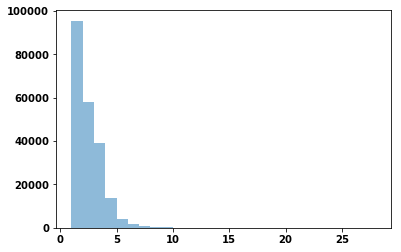

In [23]:
mylist = list(set(df_test2_4_clothes_mean))
plt.hist(df_test2_1_clothes_mean,bins=mylist,  alpha=0.5)

#  滿件折扣 各個折扣數 發行出去有使用的 數量

In [20]:
df_test1_3 = df_test1.groupby(by=['PromotionCondition_TotalQty'])['quantity'].sum()


print(df_test1_3)
df_test1_3[2]/df_test1_3[4]

PromotionCondition_TotalQty
2.0    244699
4.0       923
Name: quantity, dtype: int64


265.11267605633805

_TotalQty = [df_test1_3[2],df_test1_3[4]]
plt.bar( _TotalQty,height =_TotalQty,  bins=[2,4],  alpha=0.5)

In [26]:

def get_menber(df):
    menber = []
    for i in range(df.shape[0]):

        if i==0:
            menber.append(df.index[0][0])
            continue 

        if (df.index[i][0])!=(df.index[i - 1][0]):        
            menber.append(df.index[i][0])
          
        if (df.index[i][0])==(df.index[i - 1][0]):
            continue
    return menber

In [27]:
people_yes = get_menber(df_test1_1)
people_no = get_menber(df_test2_1)

In [28]:
same_people = list(set(people_yes).intersection(people_no))


def getsamepeople(people_yes,people_no):
    same_people = []
    for x in people_yes:
        if x in people_no:
            same_people.append(x)
    return same_people
same_people = getsamepeople(people_yes,people_no)

# test1_4；test2_4：共有的人平均購買數量

In [29]:
df_test1_4 = df_test1[df_test1['MemberId'].isin(same_people)]
df_test1_4 = df_test1_4.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()


In [30]:
df_test2_4 = df_test2[df_test2['MemberId'].isin(same_people)]
df_test2_4 = df_test2_4.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()


In [31]:
df_test1_4_clothes_mean = getMeanList(df_test1_4)
df_test2_4_clothes_mean = getMeanList(df_test2_4)


In [ ]:
import plotly.plotly as py
import plotly.graph_objs as go

In [32]:
data = [go.Histogram(x=df_test2_4_clothes_mean,
                     histnorm='percent')]

layout = go.Layout(
    title='沒有使用折價卷 購物車內購買件數統計',
    xaxis=dict(
        title='件數'
    ),
    yaxis=dict(
        title='百分比'
    ),
    bargap=0,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='styled histogram')

'''data = [go.Histogram(x=clothes_mean,
                     histnorm='percent')]
plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(data, filename='normalized histogram')'''

"data = [go.Histogram(x=clothes_mean,\n                     histnorm='percent')]\nplotly.offline.init_notebook_mode(connected=True)\nplotly.offline.iplot(data, filename='normalized histogram')"

In [33]:
data = [go.Histogram(x=df_test1_4_clothes_mean,
                     histnorm='percent')]

layout = go.Layout(
    title='有使用折價卷 購物車內購買件數統計',
    xaxis=dict(
        title='件數'
    ),
    yaxis=dict(
        title='百分比'
    ),
    bargap=0,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='styled histogram')

In [34]:
trace1 = go.Histogram(
    x=df_test1_4_clothes_mean,
    opacity=0.75,
    name='test1',

    
)
trace2 = go.Histogram(
    x=df_test2_4_clothes_mean,
    opacity=0.75,
    name='test2',

)

data = [ trace2,trace1]
layout = go.Layout(barmode='overlay',    
    title='有使用折價卷 購物車內購買件數統計',
    xaxis=dict(
        title='件數'
    ),
    yaxis=dict(
        title='百分比'
    ),
    bargap=0,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='overlaid histogram')

In [ ]:
'0.45_', '0.79_', '0.85_', '0.88_'  

## 各個折數購買量

In [24]:
df_test1_4 = df_test1.groupby(by=['PromotionCondition_DiscountRate'])['Quantity'].sum()

df_test1_4

PromotionCondition_DiscountRate
0.45     10338
0.79      5937
0.85     61005
0.88    174056
Name: Quantity, dtype: int64

# df_test3 所有使用折價卷的購買

df_test3 = promocondi[promocondi.DiscountType=='滿件打折']
df_test3['quantity'] =  1


df_test3_1 = df_test3.groupby(by=['PromotionCondition_DiscountRate'])['quantity'].sum()
df_test3_1

# 找不到 滿件打折 的發行量

PromotionCondition_DiscountRate
0.45     10107
0.50       572
0.79      5799
0.85     59396
0.88    170340
Name: quantity, dtype: int64

# df_test0  是一個蒐集更多關於  '滿件打折'   的資料集

In [35]:

df_test0 = ordpromocondi[ordpromocondi.DiscountType=='滿件打折'].loc[:,    
        [
       'SalesOrderSlaveId',
       'MemberId', 
       'TradesOrderSlaveId',
       'TradesOrderGroupCode', 
       'DateId',
       'Quantity', 
       'UnitPrice',
       'PromotionDiscount', 
       'EcouponDiscount', 
       'SalesOrderSlaveTotalPayment',


       'SalesOrderSlavePromotionDiscount',
       'SalesOrderSlavePromotionDiscountRate',
       'SalesOrderSlavePromotionDiscountAllocated',
       'SalesOrderSlavePromotionDiscountAllocatedQty',

       'PromotionCondition_DiscountRate',
       'PromotionCondition_TotalQty', 

       'DiscountType' ]]
df_test0

,SalesOrderSlaveId,MemberId,TradesOrderSlaveId,TradesOrderGroupCode,DateId,Quantity,UnitPrice,PromotionDiscount,EcouponDiscount,SalesOrderSlaveTotalPayment,SalesOrderSlavePromotionDiscount,SalesOrderSlavePromotionDiscountRate,SalesOrderSlavePromotionDiscountAllocated,SalesOrderSlavePromotionDiscountAllocatedQty,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,DiscountType
29,50909705,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50973437,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",20180102,1,690.0,-366.0,0.0,324.0,0.0,0.45,-366.0,1.0,0.45,2.0,滿件打折
30,50909706,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50973438,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",20180102,1,740.0,-405.0,0.0,335.0,0.0,0.45,-405.0,1.0,0.45,2.0,滿件打折
32,50913757,241AA95E-6A4D-4B07-BDE7-DF5D2730DCC1,50977491,b'\xee\xdd\xf5\xe8\x1b\x1b\xdf\x1dU\xd4\x0f\x1...,20180102,1,790.0,-461.0,0.0,329.0,0.0,0.45,-384.0,1.0,0.45,2.0,滿件打折
34,50913828,19690996-39DC-4FE4-9A4D-C883068022DF,50977562,b'R\x07\x9ao\xe6G\xe9\x8b\x80\x9e<[\x175j\x18f...,20180102,1,690.0,-386.0,0.0,304.0,0.0,0.45,-386.0,1.0,0.45,2.0,滿件打折
92,51052321,759BE3F2-1095-420F-B44E-3BA0F1BFB36B,51116048,b'R*\xb51\x97g}5\xbawXIH\x95\x99\xcf\x0e\x84\x...,20180104,1,690.0,-102.0,0.0,588.0,0.0,0.85,-102.0,1.0,0.85,2.0,滿件打折
95,51007458,C23CBCD1-C25F-4389-8420-9A3248E54543,51071180,b'msS\x93\xf1=\x93({\x83\x84\xae]\x9c\xac<\xbd...,20180104,1,299.0,-48.0,0.0,251.0,0.0,0.85,-48.0,1.0,0.85,2.0,滿件打折
98,51007460,C23CBCD1-C25F-4389-8420-9A3248E54543,51071182,b'msS\x93\xf1=\x93({\x83\x84\xae]\x9c\xac<\xbd...,20180104,1,299.0,-44.0,0.0,255.0,0.0,0.85,-44.0,1.0,0.85,2.0,滿件打折
103,48375778,4C4F073A-F102-4407-B23C-57A96DFC0F92,48439077,"b""\xae\xef\x96\xdaT\x18L \x87%\xf2\x96\xe1\xa2...",20171126,1,690.0,-117.0,-24.0,549.0,0.0,0.88,-81.0,1.0,0.88,2.0,滿件打折
107,48386896,CBC4C894-4A02-40E6-B9BD-2FD02AFDD604,48450195,b'\xa6\xb2<\xbd\xc0\xfd\xc4\x08\x9c\x05\x81\x7...,20171126,1,690.0,-134.0,-27.0,529.0,0.0,0.88,-95.0,1.0,0.88,2.0,滿件打折
110,51020116,3DF2DC31-AA4D-4109-B875-E97104B11102,51083849,b'\xcft\x00\xac\xd1\xb7;\x8dx\xec\xd0\xb9\xb5~...,20180104,1,640.0,-97.0,0.0,543.0,0.0,0.85,-97.0,1.0,0.85,2.0,滿件打折


# df_test1_3 、、   df_test2_3  是購買金額的groupby

In [36]:
df_test1_3 = df_test1[df_test1['MemberId'].isin(same_people)]
df_test1_3 = df_test1_3.groupby(by=['MemberId','TradesOrderGroupCode'])['SalesOrderSlaveTotalPayment'].sum()

df_test2_3 = df_test2[df_test2['MemberId'].isin(same_people)]
df_test2_3 = df_test2_3.groupby(by=['MemberId','TradesOrderGroupCode'])['SalesOrderSlaveTotalPayment'].sum()

# df_test2是沒有使用折價卷的族群

# 將分群塞選成 和df_test1_5一樣

In [37]:
df_test1_3_pay = getMeanList(df_test1_3)
df_test2_3_pay = getMeanList(df_test2_3)

In [38]:
data = [go.Histogram(x=df_test1_3_pay,
                     histnorm="")]

layout = go.Layout(
    title='有使用折價卷 用購物車 歸類 的購買金額統計',
    xaxis=dict(
        title='金額區間'
    ),
    yaxis=dict(
        title='數量'
    ),
    bargap=0,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='styled histogram')

In [39]:
# filter(lambda a: a != 0, df_test1_3_pay)
# df_test2_3_pay的零值太多了


while(1):
    df_test2_3_pay.remove(0)

# (lambda a: a != 0, df_test2_3_pay)

ValueError: list.remove(x): x not in list

In [ ]:
data = [go.Histogram(x=df_test2_3_pay,
                     histnorm="")]

layout = go.Layout(
    title='沒有使用折價卷 用購物車 歸類 的購買金額統計',
    xaxis=dict(
        title='金額區間'
    ),
    yaxis=dict(
        title='數量'
    ),
    bargap=0,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='styled histogram')

In [40]:
trace1 = go.Histogram(
    x=df_test1_3_pay,
    opacity=0.75,
    name='test1'
    
)
trace2 = go.Histogram(
    x=df_test2_3_pay,
    opacity=0.75,
    name='test2'
)

data = [trace1, trace2]
layout = go.Layout(barmode='overlay')
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='overlaid histogram')

# 下面可以稍微算一下投資回報率

* ### 也就是要算一下PromotionDiscount	-> 這簡單

* ### 以購物車平均購買	->   以人平均購買

* ### 也就是要算一下PromotionDiscount	-> 這簡單

# test1_5；test2_5：平均折扣  金額

In [41]:
df_test1_5 = df_test1[df_test1['MemberId'].isin(same_people)]
df_test1_5 = df_test1_5.groupby(by=['MemberId','TradesOrderGroupCode'])['PromotionDiscount'].sum()
df_test1_5_Discount = getMeanList(df_test1_5)
df_test1_5_Discount = [ -x for x in df_test1_5_Discount]

In [ ]:
df_test2_5 = df_test2[df_test2['MemberId'].isin(same_people)]
df_test2_5 = df_test2_5.groupby(by=['MemberId','TradesOrderGroupCode'])['PromotionDiscount'].sum()
df_test2_5_Discount = getMeanList(df_test2_5)
df_test2_5_Discount = [ -x for x in df_test2_5_Discount]

In [42]:
data = [go.Histogram(x=df_test1_5_Discount)]

layout = go.Layout(
    title='有使用折價卷 購物車內平均折扣金額  統計',
    xaxis=dict(
        title='件數'
    ),
    yaxis=dict(
        title='百分比'
    ),
    bargap=0,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='styled histogram')

In [43]:
trace1 = go.Histogram(
    x=df_test1_5_Discount,
    opacity=0.75,
    name='cost',

    
)
trace2 = go.Histogram(
    x=df_test1_3_pay,
    opacity=0.75,
    name='test1'
    
)
trace3 = go.Histogram(
    x=df_test2_3_pay,
    opacity=0.75,
    name='test2'
)


data = [trace3,trace2,trace1]
layout = go.Layout(barmode='overlay',    
    title='有使用折價卷 購物車內購買件數統計',
    xaxis=dict(
        title='件數'
    ),
    yaxis=dict(
        title='百分比'
    ),
    bargap=0,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='overlaid histogram')

In [47]:
trace0 = go.Box(
    y=df_test1_5_Discount,
    name = 'cost',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=df_test1_3_pay,
    name = 'test1',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
trace2 = go.Box(
    y=df_test2_3_pay,
    name = 'test2',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
data = [trace0, trace1, trace2]

layout = go.Layout(barmode='overlay',    
    title='有使用折價卷 購物車內購買件數統計',

    yaxis=dict(
        title='金額'
    ),
    bargap=0,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='overlaid histogram')

In [49]:
trace0 = go.Bar(
    x=['金額' ],
    y=[sum(df_test1_3_pay)],
    name='test1'
)
trace1 = go.Bar(
    x=['金額' ],
    y=[sum(df_test2_3_pay)],
    name='test2'
)
trace2 = go.Bar(
    x=['金額'],
    y=[sum(df_test1_5_Discount)],
    name='promotion cost'
)

data = [trace0, trace1, trace2]
layout = go.Layout(
    barmode='group'
)

# fig = go.Figure(data=data, layout=layout)
# py.iplot(fig, filename='grouped-bar')
plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(data , filename='grouped-bar')

使用卷 消費的金額 - 未使用卷 消費的金額 - 投入卷 耗費的成本

In [94]:
sum(df_test1_3_pay) -  sum(df_test2_3_pay) -  sum(df_test1_5_Discount)

27005103

sum(df_test1_3_pay)

sum(df_test2_3_pay) 

sum(df_test1_5_Discount)

### 抓出用0.45的那群人

In [ ]:
x=['0.45_', '0.79_', '0.85_', '0.88_'],

In [52]:
df_test1_6 = df_test1[df_test1.PromotionCondition_DiscountRate==0.45]

In [53]:
df_test1_6.head(6)

,MemberId,SalesOrderSlaveId,TradesOrderSlaveId,TradesOrderGroupCode,DateId,Quantity,UnitPrice,PromotionDiscount,EcouponDiscount,SalesOrderSlaveTotalPayment,SalesOrderSlavePromotionDiscount,SalesOrderSlavePromotionDiscountRate,SalesOrderSlavePromotionDiscountAllocated,SalesOrderSlavePromotionDiscountAllocatedQty,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,quantity
29,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50909705,50973437,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",20180102,1,690.0,-366.0,0.0,324.0,0.0,0.45,-366.0,1.0,0.45,2.0,1
30,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50909706,50973438,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",20180102,1,740.0,-405.0,0.0,335.0,0.0,0.45,-405.0,1.0,0.45,2.0,1
32,241AA95E-6A4D-4B07-BDE7-DF5D2730DCC1,50913757,50977491,b'\xee\xdd\xf5\xe8\x1b\x1b\xdf\x1dU\xd4\x0f\x1...,20180102,1,790.0,-461.0,0.0,329.0,0.0,0.45,-384.0,1.0,0.45,2.0,1
34,19690996-39DC-4FE4-9A4D-C883068022DF,50913828,50977562,b'R\x07\x9ao\xe6G\xe9\x8b\x80\x9e<[\x175j\x18f...,20180102,1,690.0,-386.0,0.0,304.0,0.0,0.45,-386.0,1.0,0.45,2.0,1
5848,DF95F6D0-91A1-4504-868A-A878BBF4BC5B,50914428,50978162,b'@\xf9\xd7\x1a\xb2\xc8\x9f]J\x10` \x81*\x9c\x...,20180102,1,280.0,-210.0,0.0,70.0,0.0,0.45,-65.0,1.0,0.45,2.0,1
6347,22B7DC49-B123-4E84-A4A5-298ECEDFCF8F,50915983,50979721,b'\xf8Z\x8c\x19\xb1\x900\xb01\x04Mi\xf9R\xd0\x...,20180102,1,540.0,-306.0,0.0,234.0,0.0,0.45,-306.0,1.0,0.45,2.0,1


In [54]:
type(DiscountRate)

numpy.ndarray

In [55]:
df_test1_6_people_45 = df_test1_6.MemberId.unique()

In [56]:
df_test1_6_people_45 = df_test1_6_people_45.tolist()

有使用過滿件打折，折數為0.45的用戶的所有訂單

### 沒有用折價卷時候的購買數量

In [77]:
df_test1_7 = df_test2[df_test2['MemberId'].isin(df_test1_6_people_45)]
df_test1_7 = df_test1_7.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
df_test1_7_QuantityMean = getMeanList(df_test1_7)
mylist = list(set(df_test1_7_QuantityMean))
# plt.hist(df_test1_7_QuantityMean,bins=mylist,  alpha=0.5)

data = [go.Histogram( x=df_test1_7_QuantityMean)]
plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(data, filename='histogram',validate=False)

In [78]:
unuse_ecoupon = df_test1_7_QuantityMean

### 有用滿件打折時候的購買數量

In [79]:
df_test1_7 = df_test0[df_test0['MemberId'].isin(df_test1_6_people_45)]
df_test1_7 = df_test1_7.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
df_test1_7_QuantityMean = getMeanList(df_test1_7)

In [75]:
data = [go.Histogram( x=df_test1_7_QuantityMean)]
plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(data, filename='histogram',validate=False)

In [84]:
trace1 = go.Histogram(
    x=unuse_ecoupon ,
    opacity=0.75,
    name='general',

)
trace2 = go.Histogram(
    x=df_test1_7_QuantityMean,
    opacity=0.75,
    name='useCoupon'
)

data = [trace2,trace1]
layout = go.Layout(barmode='overlay',    
    title='有使用折價卷 購物車內購買件數統計',
    xaxis=dict(
        title='件數'
    ),
    yaxis=dict(
        title='百分比'
    ),
    bargap=0,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='overlaid histogram')

In [112]:
def difficult_people(percent):
    df_test1_6 = df_test1[df_test1.PromotionCondition_DiscountRate==percent]
    df_test1_6_people_45 = df_test1_6.MemberId.unique()
    df_test1_6_people_45 = df_test1_6_people_45.tolist()


    df_test1_7 = df_test2[df_test2['MemberId'].isin(df_test1_6_people_45)]
    df_test1_7 = df_test1_7.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
    df_test1_7_QuantityMean = getMeanList(df_test1_7)
    mylist = list(set(df_test1_7_QuantityMean))
    # plt.hist(df_test1_7_QuantityMean,bins=mylist,  alpha=0.5)
    data = [go.Histogram( x=df_test1_7_QuantityMean)]
    plotly.offline.init_notebook_mode(connected=True)
    plotly.offline.iplot(data, filename='histogram',validate=False)
    unuse_ecoupon = df_test1_7_QuantityMean

    df_test1_7 = df_test0[df_test0['MemberId'].isin(df_test1_6_people_45)]
    df_test1_7 = df_test1_7.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
    df_test1_7_QuantityMean = getMeanList(df_test1_7)
    data = [go.Histogram( x=df_test1_7_QuantityMean)]
    plotly.offline.init_notebook_mode(connected=True)
    plotly.offline.iplot(data, filename='histogram',validate=False)


    trace1 = go.Histogram(
        x=unuse_ecoupon ,
        opacity=0.75,
        name='general',

    )
    trace2 = go.Histogram(
        x=df_test1_7_QuantityMean,
        opacity=0.75,
        name='useCoupon'
    )

    data = [trace2,trace1]
    layout = go.Layout(barmode='overlay',    
        title='有使用折價卷 購物車內購買件數統計',
        xaxis=dict(
            title='件數'
        ),
        yaxis=dict(
            title='百分比'
        ),
        bargap=0,
        bargroupgap=0.1
    )
    fig = go.Figure(data=data, layout=layout)

    plotly.offline.init_notebook_mode(connected=True)
    plotly.offline.iplot(fig, filename='overlaid histogram')


    df_test2_8 = df_test2[df_test2['MemberId'].isin(df_test1_6_people_45)]['MemberId'].unique()
    df_test1_8 = df_test0[df_test0['MemberId'].isin(df_test1_6_people_45)]['MemberId'].unique()
    df_test2_8.tolist()
    df_test1_8.tolist()

    different_people = list(set(df_test1_8) - set(df_test2_8))

    df_test1_7 = df_test0[df_test0['MemberId'].isin(different_people)]
    df_test1_7 = df_test1_7.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
    df_test1_7_QuantityMean = getMeanList(df_test1_7)
    data = [go.Histogram( x=df_test1_7_QuantityMean)]
    plotly.offline.init_notebook_mode(connected=True)
    plotly.offline.iplot(data, filename='histogram',validate=False)
    
    return different_people #難請的客人

In [113]:
different_people_79 = difficult_people(0.79)
different_people_85 = difficult_people(0.85)
different_people_88 = difficult_people(0.88)

In [114]:
len(different_people_79)

551

In [115]:
len(different_people_85)

4407

In [116]:
len(different_people_88)

8276

In [121]:
len(list(set(different_people_79) - set(different_people_45)))

551

In [122]:
len(list(set(different_people_85) - set(different_people_79)))

4402

In [123]:
len(list(set(different_people_88) - set(different_people_85)))

8169

In [124]:
len(list(set(different_people_88) - set(different_people_45)))

8256

# 九一APP在使用0.45798588 的用戶都是分開的根本沒做實驗

# 可以做報告了 用圖表呈現

In [ ]:
x=['0.45_', '0.79_', '0.85_', '0.88_'],

In [91]:
df_test2_8 = df_test2[df_test2['MemberId'].isin(df_test1_6_people_45)]['MemberId'].unique()
df_test1_8 = df_test0[df_test0['MemberId'].isin(df_test1_6_people_45)]['MemberId'].unique()

In [ ]:
same_people = list(set(people_yes).intersection(people_no))

In [95]:
df_test2_8.tolist()
df_test1_8.tolist()

['F51F1B83-4195-4B70-8E40-B8888F4A46D6',
 '241AA95E-6A4D-4B07-BDE7-DF5D2730DCC1',
 '19690996-39DC-4FE4-9A4D-C883068022DF',
 'F27923DF-D3B5-4CBB-A21D-71BFA5BCEEC8',
 '8F23EA3B-DB0C-4BE3-9F44-339BAEDD0DE1',
 '7CFEDFDA-133A-4CCD-A84A-EF3D920E265B',
 '38AFB377-39E8-4009-85DF-FFF6C84FAE67',
 'DF95F6D0-91A1-4504-868A-A878BBF4BC5B',
 '22B7DC49-B123-4E84-A4A5-298ECEDFCF8F',
 '1DF155F2-D639-42DC-8072-3B81DCE5908B',
 '2C923801-DF40-4819-8C19-2E6AB0337B9A',
 'B1D3B3F1-5962-4F66-BE2B-9354CC966BA8',
 '35B4882D-3221-479A-A278-7B41E6444202',
 'C6C6031F-0C63-4B00-9E1E-710A8DF93034',
 '06C906EA-22DD-4168-A468-F6761AAC092B',
 '626DDC02-AE7B-4B33-B5E2-35073AA7030D',
 'B68FBF3E-4C58-4CBC-B89B-F2455DA39BC8',
 '8A2F297C-7F98-47ED-8053-F7D061B81E29',
 '9A30C275-7BBE-4999-891C-D93AEDF9D037',
 'D8BEA78A-E5F5-4C37-A25B-1856AF72EBF1',
 '9381BC47-4FC8-4024-BB1D-5C91BC420969',
 '956E399D-BB2D-4BCD-B63E-364D912DE6E5',
 '69194A43-2977-405A-A165-7FB525497FF2',
 '9121CD24-3CE8-4E4F-9687-222A59FB5D78',
 'F33F838E-D994-

### 有使用過滿件折扣45折的會員數

In [125]:
len(df_test1_8)

1854

### 在上面的會員之中，沒有用過折價卷購物的會員數

In [96]:
len(df_test2_8)

1422

### 除了使用過滿件折扣45折購買過衣服之外，就再也沒有購買過衣服的人數有432人

In [127]:
len(list(set(df_test1_8) - set(df_test2_8)))

432

In [ ]:
df_test2_8 = df_test2[df_test2['MemberId'].isin(different_people)]

In [102]:
df_test1_7 = df_test0[df_test0['MemberId'].isin(different_people)]
df_test1_7 = df_test1_7.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
df_test1_7_QuantityMean = getMeanList(df_test1_7)
data = [go.Histogram( x=df_test1_7_QuantityMean)]
plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(data, filename='histogram',validate=False)

# 從下面看有432人要有0.45的折價卷才請得動

In [ ]:
df_test0[df_test0['MemberId'].isin(different_people)]

In [104]:
bb = ordpromocondi[(ordpromocondi['MemberId'].isin(different_people))&(ordpromocondi.DiscountType!='滿件打折')]

In [105]:
bb = bb.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
df_test1_7_QuantityMean = getMeanList(bb)
data = [go.Histogram( x=df_test1_7_QuantityMean)]
plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(data, filename='histogram',validate=False)

In [99]:
len(different_people)

432

In [106]:
different_people_45 = different_people

In [85]:
len(unuse_ecoupon) #從未使用過 折價卷

1421

In [86]:
len(df_test1_7_QuantityMean) #使用過 滿件打折 折價卷

1854

In [87]:
len(df_test1_6_people_45)

1854

In [ ]:
df_test1_7 = df_test0[df_test0['MemberId'].isin(df_test1_6_people_45)]
df_test1_7 = df_test1_7.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
df_test1_7_QuantityMean = getMeanList(df_test1_7)
data = [go.Histogram( x=df_test1_7_QuantityMean)]
plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(data, filename='histogram',validate=False)

## 0.45 折卷 用在他們身上到到底有沒有用

# 其他 0.88 0.85 0.79 的用戶  有沒有同樣難請的

# 各個折數難請的用戶差多少

## 他們之間 的用戶有沒有一樣的

# 寫成FUNCTION

In [44]:
df_test0['Date'] = pd.to_datetime(df_test0['DateId'].astype(str), format='%Y%m%d')

from datetime import datetime


In [32]:
promotion['start'], promotion['s'] = promotion['PromotionStartDateTime'].str.split(' ', 1).str
promotion['start'] = pd.to_datetime(promotion['start'])



promotion['End'], promotion['e'] = promotion['PromotionEndDateTime'].str.split(' ', 1).str
promotion['End'] = pd.to_datetime(promotion['End'])

promotion.drop(['s','e'], axis=1)

promotion['period'] = promotion['End'] - promotion['start']
promotion['period'] = promotion['period'].dt.days


promotion.head(3)


,PromotionId,PromotionStartDateTime,PromotionEndDateTime,PromotionValidFlag,DiscountType,start,s,End,e,period
0,1,2015-05-06 09:00:00.000,2015-05-29 11:00:00.000,0,NaN,2015-05-06,09:00:00.000,2015-05-29,11:00:00.000,23
1,2,2015-05-21 18:00:00.000,2015-05-21 19:00:00.000,0,NaN,2015-05-21,18:00:00.000,2015-05-21,19:00:00.000,0
2,3,2015-06-02 16:00:00.000,2015-07-10 13:00:00.000,1,任選優惠價,2015-06-02,16:00:00.000,2015-07-10,13:00:00.000,38


In [127]:
promotion.head(3)

,PromotionId,PromotionStartDateTime,PromotionEndDateTime,PromotionValidFlag,DiscountType,start,s,End,e,period
0,1,2015-05-06 09:00:00.000,2015-05-29 11:00:00.000,0,NaN,2015-05-06,09:00:00.000,2015-05-29,11:00:00.000,23
1,2,2015-05-21 18:00:00.000,2015-05-21 19:00:00.000,0,NaN,2015-05-21,18:00:00.000,2015-05-21,19:00:00.000,0
2,3,2015-06-02 16:00:00.000,2015-07-10 13:00:00.000,1,任選優惠價,2015-06-02,16:00:00.000,2015-07-10,13:00:00.000,38


In [40]:
# pd.to_datetime(promotion['start']).dt.month
# promotion.info()


## 查看一下每一種優惠方式大概  都間隔幾天

In [ ]:
test_period

In [69]:
test_period.drop(['PromotionId'], axis=1)
test_period

PromotionId  PromotionValidFlag
DiscountType period                                 
任選優惠價        1         58.333333                1.00
             6         33.000000                1.00
             7         74.166667                1.00
             8         44.666667                1.00
             9        120.333333                1.00
             11        18.000000                1.00
             12        43.000000                1.00
             13        32.500000                1.00
             14        52.500000                1.00
             15        73.000000                1.00
             17       183.500000                1.00
             19       103.000000                1.00
             20       200.000000                1.00
             21        48.500000                1.00
             23        45.000000                1.00
             27       169.833333                1.00
             28        86.833333                1.00
             31        13.500000                1.00
             32        92.333333                1.00
             35        61.000000                1.00
             38         4.000000                1.00
             42        49.000000                1.00
             43       218.500000                1.00
             50        39.000000                1.00
             53         7.500000                1.00
             55       136.333333                1.00
             56        35.666667                1.00
             58         4.000000                1.00
             60       135.750000                1.00
             61       119.000000                1.00
...                          ...                 ...
滿額折現         1        111.600000                0.20
             2         97.000000                1.00
             3         88.000000                1.00
             4        124.000000                1.00
             5         98.750000                0.75
             6        119.500000                1.00
             7        136.250000                1.00
             8        191.000000                1.00
             9        171.500000                1.00
             10        99.000000                1.00
             11       128.500000                1.00
             12       209.000000                1.00
             13        37.500000                1.00
             14       107.750000                1.00
             15       177.000000                1.00
             17       104.500000                1.00
             19       118.000000                1.00
             21       143.500000                1.00
滿額贈          1        121.571429                1.00
             3        135.000000                1.00
             7        126.000000                1.00
             8        150.000000                1.00
             9        211.000000                1.00
             10       128.666667                1.00
             14       122.666667                1.00
             15       156.000000                1.00
             16       172.000000                0.75
             17       168.000000                1.00
             18       168.000000                1.00
             21       155.000000                1.00

[98 rows x 2 columns]

In [33]:
test_period = pd.pivot_table(promotion,  index=['DiscountType','period'])

test_period.drop(['PromotionId'], axis=1)
test_period

PromotionId  PromotionValidFlag
DiscountType period                                 
任選優惠價        1         58.333333                1.00
             6         33.000000                1.00
             7         74.166667                1.00
             8         44.666667                1.00
             9        120.333333                1.00
             11        18.000000                1.00
             12        43.000000                1.00
             13        32.500000                1.00
             14        52.500000                1.00
             15        73.000000                1.00
             17       183.500000                1.00
             19       103.000000                1.00
             20       200.000000                1.00
             21        48.500000                1.00
             23        45.000000                1.00
             27       169.833333                1.00
             28        86.833333                1.00
             31        13.500000                1.00
             32        92.333333                1.00
             35        61.000000                1.00
             38         4.000000                1.00
             42        49.000000                1.00
             43       218.500000                1.00
             50        39.000000                1.00
             53         7.500000                1.00
             55       136.333333                1.00
             56        35.666667                1.00
             58         4.000000                1.00
             60       135.750000                1.00
             61       119.000000                1.00
...                          ...                 ...
滿額折現         1        111.600000                0.20
             2         97.000000                1.00
             3         88.000000                1.00
             4        124.000000                1.00
             5         98.750000                0.75
             6        119.500000                1.00
             7        136.250000                1.00
             8        191.000000                1.00
             9        171.500000                1.00
             10        99.000000                1.00
             11       128.500000                1.00
             12       209.000000                1.00
             13        37.500000                1.00
             14       107.750000                1.00
             15       177.000000                1.00
             17       104.500000                1.00
             19       118.000000                1.00
             21       143.500000                1.00
滿額贈          1        121.571429                1.00
             3        135.000000                1.00
             7        126.000000                1.00
             8        150.000000                1.00
             9        211.000000                1.00
             10       128.666667                1.00
             14       122.666667                1.00
             15       156.000000                1.00
             16       172.000000                0.75
             17       168.000000                1.00
             18       168.000000                1.00
             21       155.000000                1.00

[98 rows x 2 columns]

promotion['2015-07-06':'2015-11-06']

## 這只是要找特定月份而已

In [46]:
promotion[pd.to_datetime(promotion['start']).dt.month==5]

,PromotionId,PromotionStartDateTime,PromotionEndDateTime,PromotionValidFlag,DiscountType,start,s,End,e,period
0,1,2015-05-06 09:00:00.000,2015-05-29 11:00:00.000,0,NaN,2015-05-06,09:00:00.000,2015-05-29,11:00:00.000,23
1,2,2015-05-21 18:00:00.000,2015-05-21 19:00:00.000,0,NaN,2015-05-21,18:00:00.000,2015-05-21,19:00:00.000,0
33,34,2016-05-04 18:00:00.000,2016-05-05 00:20:00.000,1,任選優惠價,2016-05-04,18:00:00.000,2016-05-05,00:20:00.000,1
34,35,2016-05-05 09:31:00.000,2016-05-18 17:59:00.000,1,任選優惠價,2016-05-05,09:31:00.000,2016-05-18,17:59:00.000,13
35,36,2016-05-11 18:00:00.000,2016-05-19 10:59:00.000,1,任選優惠價,2016-05-11,18:00:00.000,2016-05-19,10:59:00.000,8
36,37,2016-05-18 18:00:00.000,2016-06-08 17:59:00.000,1,任選優惠價,2016-05-18,18:00:00.000,2016-06-08,17:59:00.000,21
37,38,2016-05-19 11:00:00.000,2016-05-25 17:59:00.000,1,任選優惠價,2016-05-19,11:00:00.000,2016-05-25,17:59:00.000,6
38,39,2016-05-24 16:10:00.000,2016-07-13 17:59:00.000,1,任選優惠價,2016-05-24,16:10:00.000,2016-07-13,17:59:00.000,50
39,40,2016-05-25 10:20:00.000,2016-06-15 17:59:00.000,1,任選優惠價,2016-05-25,10:20:00.000,2016-06-15,17:59:00.000,21
40,41,2016-05-25 18:00:00.000,2016-06-22 17:59:00.000,1,任選優惠價,2016-05-25,18:00:00.000,2016-06-22,17:59:00.000,28


In [47]:
ecoupon

,EcouponId,EcouponTypeDef,EcouponPurposeDef,ECouponStartDateTime,ECouponEndDateTime,ECouponDiscountPrice,ECouponTotalQty,ECouponQtyLimit,ECouponTotalGiftLimit,ECouponValidFlag,ECouponIsAppDrawOut,ECouponIsWebDrawOut,ECouponMaxDiscountLimit
0,1,Gift,Marketing,2014-07-21 08:00:00.000,2014-08-03 23:59:00.000,100.0,150000,0,50,1,1,0,0.30
1,2,Gift,Marketing,2014-08-05 14:00:00.000,2014-08-17 23:59:00.000,100.0,150000,0,50,1,1,0,0.30
2,3,Code,Marketing,2014-08-21 17:00:00.000,2014-08-31 23:30:00.000,100.0,30,0,0,1,1,0,0.30
3,4,Code,Marketing,2014-09-02 16:00:00.000,2014-09-30 23:59:00.000,100.0,1,1500,0,1,1,0,0.30
4,5,Code,Marketing,2014-09-10 20:00:00.000,2014-09-21 23:30:00.000,100.0,1,60,0,1,1,1,0.30
5,6,Code,Marketing,2014-09-23 15:00:00.000,2014-09-24 15:00:00.000,100.0,1,30,0,1,1,1,0.30
6,7,Code,Marketing,2014-09-24 15:00:00.000,2014-09-25 15:00:00.000,100.0,1,30,0,1,1,1,0.30
7,8,Code,Marketing,2014-09-25 15:00:00.000,2014-09-26 15:00:00.000,100.0,1,30,0,1,1,1,0.30
8,9,Code,Marketing,2014-09-26 15:00:00.000,2014-09-27 15:00:00.000,100.0,1,30,0,1,1,1,0.30
9,10,Code,Marketing,2014-09-29 15:00:00.000,2014-09-30 15:00:00.000,100.0,1,30,0,1,1,1,0.30


In [64]:
ecoupon.EcouponPurposeDef.unique()

array(['Marketing', 'CustomerCare'], dtype=object)

In [66]:
ecoupon.ECouponQtyLimit.unique()

array([     0,   1500,     60,     30,    150,     50,     20,      5,
            1,    600,   1000,    999,     99,    400,   6000,     15,
          620,     10,    100,   9999,    333,   1200,      2,   3333,
          300,   3000,  10000, 999999, 100000,   6666,  18000,  34427,
        22774,  45509,  11305,  11309,     40,  60000,  99999,      3,
        66666], dtype=int64)

In [50]:
PromotionDiscountAllocatedQty = ordpromocondi[ordpromocondi.DiscountType=='滿件打折']['SalesOrderSlavePromotionDiscountAllocatedQty']

In [51]:
data = [go.Histogram(x=PromotionDiscountAllocatedQty,
                     histnorm="")]

layout = go.Layout(
    title='折扣攤提商品件數',
    xaxis=dict(
        title='件數'
    ),
    yaxis=dict(
        title='數量'
    ),
    bargap=0,
    bargroupgap=0.1
)
fig = go.Figure(data=data, layout=layout)

plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot(fig, filename='styled histogram')

In [ ]:

'Recency',表示客戶最近一次購買的時間有多遠
'Frequency',表示客戶在最近一段時間內購買的次數
'Monetary',最近一段時間內購買的金額

In [36]:
member_RFM = member.loc[:,['MemberId','Recency','Frequency','Monetary']]
quantiles = member_RFM.quantile(q=[0.20,0.40,0.60,0.80])
quantiles

,Recency,Frequency,Monetary
0.2,-1.0,0.0,0.0
0.4,0.0,1.0,99.0
0.6,216.0,1.0,792.0
0.8,504.0,2.0,1729.0


In [37]:
quantiles = quantiles.to_dict()
quantiles
rfm = member_RFM

#### x 是引入要比較的數值
#### p 是遞迴值
#### d 是先設好的quantiles字典

In [38]:
def RClass(x,p,d):
    if x <= d[p][0.20]:
        return 1
    elif x <= d[p][0.40]:
        return 2
    elif x <= d[p][0.60]: 
        return 3
    elif x <= d[p][0.80]: 
        return 4
    else:
        return 5
    
def FMClass(x,p,d):
    if x <= d[p][0.20]:
        return 5
    elif x <= d[p][0.40]:
        return 4
    elif x <= d[p][0.60]:
        return 3
    elif x <= d[p][0.80]: 
        return 2
    else:
        return 1

In [39]:
###### rfm.apply()
rfm['R_Quartile'] = rfm['Recency'].apply(RClass, args=('Recency',quantiles,))
rfm['F_Quartile'] = rfm['Frequency'].apply(FMClass, args=('Frequency',quantiles,))
rfm['M_Quartile'] = rfm['Monetary'].apply(FMClass, args=('Monetary',quantiles,))

In [40]:
rfm['RFMClass'] = rfm.R_Quartile.map(str) + rfm.F_Quartile.map(str) + rfm.M_Quartile.map(str)

In [41]:
rfm.head()

,MemberId,Recency,Frequency,Monetary,R_Quartile,F_Quartile,M_Quartile,RFMClass
0,88812F54-9F19-49C0-BC77-86065C356D26,251,3,4011.0,4,1,1,411
1,AB3232A1-03C6-4425-8062-EEECB633FB5A,-1,0,0.0,1,5,5,155
2,CC63B70D-CD6D-4538-BDDE-4B293F95A654,659,1,529.0,5,4,3,543
3,17ED6C4D-0B91-4EB4-9992-117E9440425D,56,3,2438.0,3,1,1,311
4,1BA9F6E3-67FD-4AAF-8011-2CBEA98B4828,717,1,550.0,5,4,3,543


In [44]:
rfm[rfm['RFMClass']=='111'].sort_values('Monetary', ascending=False)

,MemberId,Recency,Frequency,Monetary,R_Quartile,F_Quartile,M_Quartile,RFMClass


In [43]:
rfm[rfm['RFMClass']=='011'].sort_values('Monetary', ascending=False)

,MemberId,Recency,Frequency,Monetary,R_Quartile,F_Quartile,M_Quartile,RFMClass


In [45]:
def classifier(row):
    if row['RFMClass']=='555':
        return '重要價值客戶'
    elif row['RFMClass']=='155':
        return '重要喚回客戶'
    elif row['RFMClass']=='515':
        return '重要深耕客戶'
    elif row['RFMClass']=='115':
        return '重要挽留客戶'
    elif row['RFMClass']=='511':
        return '新客戶'
    elif row['RFMClass']=='111':
        return '流失客戶'
    else:
        return 'other'

In [46]:
rfm['newclass'] = rfm.apply(classifier, axis=1)

In [47]:
set(rfm['newclass'])

{'other', '新客戶', '重要喚回客戶'}

In [48]:
print(rfm.loc[rfm['newclass']!='other',['MemberId', 'newclass']])

                                    MemberId newclass
1       AB3232A1-03C6-4425-8062-EEECB633FB5A   重要喚回客戶
6       93FC0272-134F-48FF-8678-AD4A4DBB5069   重要喚回客戶
7       D8A55D64-AEB0-4DC4-85C6-3372238C46D3   重要喚回客戶
9       761C39F9-CDA6-44E2-AFA8-7A1CAA037573   重要喚回客戶
10      78FB737B-5BD4-48BD-8A4F-E39E6F2E7DB5   重要喚回客戶
13      52B48400-EB1B-4797-9430-52C7398E28D2   重要喚回客戶
14      059EE4B4-13A3-471D-80F1-AD897227E8A2   重要喚回客戶
17      ECCC9C73-E4B5-4052-9688-1CE4EC33D086   重要喚回客戶
20      9E2F2520-D00C-4759-BC8F-0A50828D69F5   重要喚回客戶
23      930A7AF9-2D4D-49D2-8BF9-6B8E0D40B1EC   重要喚回客戶
24      B8319921-51D5-4E62-A4D6-E1A6C1D99C0F   重要喚回客戶
27      1B8E29C1-3A88-43E4-989B-5046BC3676AB   重要喚回客戶
28      EACC5339-0CA9-4724-BC14-D7FBFB0AF486   重要喚回客戶
31      198326C6-1D6A-4A7C-A267-44B72EEA8289   重要喚回客戶
32      33BEEEC2-C04C-40F7-97A4-C4C9F5F9093D   重要喚回客戶
33      7B62B82B-3183-47F1-B2EB-3DAFE807D5E1   重要喚回客戶
35      D2C4288E-733B-4487-8D09-E5F7189332B2      新客戶
37      4447E134-C5E4-4BE3-9

# 這是總發行量

找一個發行量；例如100000

* 看看大家使用的狀況

* 看看大家多久後才使用

* 看看各分群 使用的狀況如何

# 通常都多久後才使用

In [ ]:
print(' ')

In [55]:
ecoupon.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1056 entries, 0 to 1055
Data columns (total 13 columns):
EcouponId                  1056 non-null int64
EcouponTypeDef             1056 non-null object
EcouponPurposeDef          1056 non-null object
ECouponStartDateTime       1056 non-null object
ECouponEndDateTime         1056 non-null object
ECouponDiscountPrice       1056 non-null float64
ECouponTotalQty            1056 non-null int64
ECouponQtyLimit            1056 non-null int64
ECouponTotalGiftLimit      1056 non-null int64
ECouponValidFlag           1056 non-null int64
ECouponIsAppDrawOut        1056 non-null int64
ECouponIsWebDrawOut        1056 non-null int64
ECouponMaxDiscountLimit    1056 non-null float64
dtypes: float64(2), int64(7), object(4)
memory usage: 107.3+ KB


In [ ]:
ordpromocondi[ordpromocondi.DiscountType=='滿件打折']

In [62]:
order.head(1)

,SalesOrderSlaveId,DateId,MemberId,TradesOrderSlaveId,ShopId,SalePageId,TradesOrderGroupCode,TrackSourceTypeDef,TrackChannelTypeDef,TrackDeviceTypeDef,...,UnitPrice,PromotionDiscount,EcouponDiscount,SalesOrderSlaveTotalPayment,SalesOrderSlaveDateTime,SalesOrderSlaveStatusDef,PayProfileTypeDef,ShippingProfileTypeDef,EcouponId,IsSalePageGift
0,26914456,20170103,48D5DE26-236E-4854-8474-B0DCEAFF4F42,26971960,1317,9804,b'q\x14\xa49\xaa\\\xecs\xff6wH\xfbXd\x93\xfbf\...,Web,Brand,Mobile,...,399.0,-25.0,0.0,374.0,2017-01-03 23:11:47.207,Finish,SevenEleven,SevenEleven,NaN,False


In [60]:
order.tail(1)

,SalesOrderSlaveId,DateId,MemberId,TradesOrderSlaveId,ShopId,SalePageId,TradesOrderGroupCode,TrackSourceTypeDef,TrackChannelTypeDef,TrackDeviceTypeDef,...,UnitPrice,PromotionDiscount,EcouponDiscount,SalesOrderSlaveTotalPayment,SalesOrderSlaveDateTime,SalesOrderSlaveStatusDef,PayProfileTypeDef,ShippingProfileTypeDef,EcouponId,IsSalePageGift
2268347,50058976,20171220,F135AC00-E702-47F1-B496-8EDCBE62EBBD,50122780,1317,10114,b'\xf4\n\x14\xdc\x85n\x17JY\x14\xb3\x99v\x15\x...,Web,Brand,PC,...,199.0,0.0,0.0,199.0,2017-12-20 16:54:19.263,Finish,SevenEleven,SevenEleven,NaN,False


In [70]:
ordpromocondi.head(4)

,SalesOrderSlaveId,DateId,MemberId,TradesOrderSlaveId,ShopId,SalePageId,TradesOrderGroupCode,TrackSourceTypeDef,TrackChannelTypeDef,TrackDeviceTypeDef,...,SalesOrderSlavePromotionDiscountAllocatedQty,SalesOrderSlavePromotionValidFlag,PromotionStartDateTime,PromotionEndDateTime,PromotionValidFlag,PromotionCondition_TotalPrice,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,PromotionCondition_DiscountPrice,DiscountType
0,26914456,20170103,48D5DE26-236E-4854-8474-B0DCEAFF4F42,26971960,1317,9804,b'q\x14\xa49\xaa\\\xecs\xff6wH\xfbXd\x93\xfbf\...,Web,Brand,Mobile,...,1.0,1.0,2017-01-03 11:00:00.000,2017-01-13 10:59:00.000,True,800.0,0.0,0.0,100.0,滿額折現
1,26914457,20170103,48D5DE26-236E-4854-8474-B0DCEAFF4F42,26971961,1317,9804,b'q\x14\xa49\xaa\\\xecs\xff6wH\xfbXd\x93\xfbf\...,Web,Brand,Mobile,...,1.0,1.0,2017-01-03 11:00:00.000,2017-01-13 10:59:00.000,True,800.0,0.0,0.0,100.0,滿額折現
2,26767644,20170101,C8B989DB-05F9-42D3-BD4F-E203482C5E58,26825136,1317,10118,b'\x1d\x8f}\x12lu>.&\xfc\xbc\xe0\xd2\xad\xe5\x...,Web,Brand,Mobile,...,1.0,1.0,2016-12-27 11:00:00.000,2017-01-03 10:59:00.000,True,1000.0,0.9,0.0,0.0,滿額打折
3,26780512,20170101,C39E36F7-5091-48DA-BE8F-8CE043E009EE,26837997,1317,10036,"b'&QI#u)\xf8\xf7\n6\x01~\xd1\xf3,\x1f\xb8\xe3\...",Web,Brand,Mobile,...,1.0,1.0,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,True,1000.0,0.0,0.0,0.0,滿額贈


In [101]:
ecoupon[ecoupon.ECouponTotalQty == 15000]

,EcouponId,EcouponTypeDef,EcouponPurposeDef,ECouponStartDateTime,ECouponEndDateTime,ECouponDiscountPrice,ECouponTotalQty,ECouponQtyLimit,ECouponTotalGiftLimit,ECouponValidFlag,ECouponIsAppDrawOut,ECouponIsWebDrawOut,ECouponMaxDiscountLimit
395,396,OpenCard,Marketing,2017-02-06 00:00:00.000,2017-05-01 11:00:00.000,100.0,15000,0,0,1,1,1,0.3
517,518,OpenCard,Marketing,2017-05-01 11:00:00.000,2017-05-31 23:59:00.000,100.0,15000,0,0,1,1,1,0.3
519,520,OpenCard,Marketing,2017-06-01 00:00:00.000,2017-06-30 23:59:00.000,100.0,15000,0,0,1,1,1,0.3
520,521,OpenCard,Marketing,2017-07-01 00:00:00.000,2017-07-31 23:59:00.000,100.0,15000,0,0,1,1,1,0.3
521,522,OpenCard,Marketing,2017-08-01 00:00:00.000,2017-08-31 23:59:00.000,100.0,15000,0,0,1,1,1,0.3
522,523,OpenCard,Marketing,2017-09-01 00:00:00.000,2017-09-30 23:59:00.000,100.0,15000,0,0,1,1,1,0.3
523,524,OpenCard,Marketing,2017-10-01 00:00:00.000,2017-10-31 23:59:00.000,100.0,15000,0,0,1,1,1,0.3
524,525,OpenCard,Marketing,2017-11-01 00:00:00.000,2017-11-30 23:59:00.000,100.0,15000,0,0,1,1,1,0.3
525,526,OpenCard,Marketing,2017-12-01 00:00:00.000,2017-12-31 23:59:00.000,100.0,15000,0,0,1,1,1,0.3


In [99]:
ecoupon[ecoupon.EcouponId == 524].head(1)

,EcouponId,EcouponTypeDef,EcouponPurposeDef,ECouponStartDateTime,ECouponEndDateTime,ECouponDiscountPrice,ECouponTotalQty,ECouponQtyLimit,ECouponTotalGiftLimit,ECouponValidFlag,ECouponIsAppDrawOut,ECouponIsWebDrawOut,ECouponMaxDiscountLimit
171,172,Code,Marketing,2015-12-30 13:00:00.000,2016-01-30 13:00:00.000,150.0,1,1,0,1,1,1,0.3


In [106]:
ordpromocondi[ordpromocondi.DiscountType=='滿件打折'].loc[:,['EcouponId','ECouponTotalQty']]

,EcouponId,ECouponTotalQty
29,NaN,NaN
30,NaN,NaN
32,NaN,NaN
34,NaN,NaN
92,NaN,NaN
95,NaN,NaN
98,NaN,NaN
103,214.0,NaN
107,214.0,NaN
110,NaN,NaN


In [65]:
ecoupon.ECouponTotalQty.unique()

array([150000,     30,      1,    600,   1000,    100,  10000,    300,
         9999,      5,    999,      3,      2, 100000,  99999,     15,
          168,  15000,   6666,  11305,   1500,    250,    310], dtype=int64)

In [102]:
ordpromocondi[ordpromocondi.EcouponId == 524].head(5)

,SalesOrderSlaveId,DateId,MemberId,TradesOrderSlaveId,ShopId,SalePageId,TradesOrderGroupCode,TrackSourceTypeDef,TrackChannelTypeDef,TrackDeviceTypeDef,...,SalesOrderSlavePromotionDiscountAllocatedQty,SalesOrderSlavePromotionValidFlag,PromotionStartDateTime,PromotionEndDateTime,PromotionValidFlag,PromotionCondition_TotalPrice,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,PromotionCondition_DiscountPrice,DiscountType


In [76]:
ordpromocondi[ordpromocondi.EcouponId==242] 

,SalesOrderSlaveId,DateId,MemberId,TradesOrderSlaveId,ShopId,SalePageId,TradesOrderGroupCode,TrackSourceTypeDef,TrackChannelTypeDef,TrackDeviceTypeDef,...,SalesOrderSlavePromotionDiscountAllocatedQty,SalesOrderSlavePromotionValidFlag,PromotionStartDateTime,PromotionEndDateTime,PromotionValidFlag,PromotionCondition_TotalPrice,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,PromotionCondition_DiscountPrice,DiscountType
1250,49465330,20171212,42BFE6C1-918E-406B-8969-81F0A934161A,49528791,1317,8319,b'\xd3\x02\xfbV\xf4U\x8a\x88\xeaLv\xc1Gns{\xc1...,Web,Brand,Mobile,...,1.0,1.0,2017-12-12 11:00:00.000,2018-01-02 10:59:00.000,True,1212.0,0.00,0.0,0.0,滿額贈
1251,49465330,20171212,42BFE6C1-918E-406B-8969-81F0A934161A,49528791,1317,8319,b'\xd3\x02\xfbV\xf4U\x8a\x88\xeaLv\xc1Gns{\xc1...,Web,Brand,Mobile,...,1.0,1.0,2017-12-05 11:11:00.000,2017-12-14 10:59:00.000,True,1000.0,0.00,0.0,0.0,滿額贈
1252,49465330,20171212,42BFE6C1-918E-406B-8969-81F0A934161A,49528791,1317,8319,b'\xd3\x02\xfbV\xf4U\x8a\x88\xeaLv\xc1Gns{\xc1...,Web,Brand,Mobile,...,1.0,1.0,2017-12-12 11:00:00.000,2017-12-19 10:59:00.000,True,1500.0,0.95,0.0,0.0,滿額打折
1255,49471237,20171212,67DAEA50-F95E-47B2-9D88-E9EC2B986F52,49534685,1317,11324,b'\x07mV\xbf\xc9N\xf8\xe3\xf9\xdd\x8a\t\xfa\x8...,AndroidApp,Brand,Mobile,...,1.0,1.0,2017-12-12 11:00:00.000,2018-01-02 10:59:00.000,True,1212.0,0.00,0.0,0.0,滿額贈
1256,49471237,20171212,67DAEA50-F95E-47B2-9D88-E9EC2B986F52,49534685,1317,11324,b'\x07mV\xbf\xc9N\xf8\xe3\xf9\xdd\x8a\t\xfa\x8...,AndroidApp,Brand,Mobile,...,1.0,1.0,2017-12-05 11:11:00.000,2017-12-14 10:59:00.000,True,1000.0,0.00,0.0,0.0,滿額贈
1257,49471237,20171212,67DAEA50-F95E-47B2-9D88-E9EC2B986F52,49534685,1317,11324,b'\x07mV\xbf\xc9N\xf8\xe3\xf9\xdd\x8a\t\xfa\x8...,AndroidApp,Brand,Mobile,...,1.0,1.0,2017-12-12 11:00:00.000,2017-12-19 10:59:00.000,True,1500.0,0.95,0.0,0.0,滿額打折
1260,49471238,20171212,67DAEA50-F95E-47B2-9D88-E9EC2B986F52,49534686,1317,11324,b'\x07mV\xbf\xc9N\xf8\xe3\xf9\xdd\x8a\t\xfa\x8...,AndroidApp,Brand,Mobile,...,1.0,1.0,2017-12-12 11:00:00.000,2018-01-02 10:59:00.000,True,1212.0,0.00,0.0,0.0,滿額贈
1261,49471238,20171212,67DAEA50-F95E-47B2-9D88-E9EC2B986F52,49534686,1317,11324,b'\x07mV\xbf\xc9N\xf8\xe3\xf9\xdd\x8a\t\xfa\x8...,AndroidApp,Brand,Mobile,...,1.0,1.0,2017-12-05 11:11:00.000,2017-12-14 10:59:00.000,True,1000.0,0.00,0.0,0.0,滿額贈
1262,49471238,20171212,67DAEA50-F95E-47B2-9D88-E9EC2B986F52,49534686,1317,11324,b'\x07mV\xbf\xc9N\xf8\xe3\xf9\xdd\x8a\t\xfa\x8...,AndroidApp,Brand,Mobile,...,1.0,1.0,2017-12-12 11:00:00.000,2017-12-19 10:59:00.000,True,1500.0,0.95,0.0,0.0,滿額打折
1263,49471239,20171212,67DAEA50-F95E-47B2-9D88-E9EC2B986F52,49534687,1317,16021,b'\x07mV\xbf\xc9N\xf8\xe3\xf9\xdd\x8a\t\xfa\x8...,AndroidApp,Brand,Mobile,...,1.0,1.0,2017-12-12 11:00:00.000,2018-01-02 10:59:00.000,True,1212.0,0.00,0.0,0.0,滿額贈


#### 發行總數 根本沒屁用




In [68]:
df_test0.head(4)

,SalesOrderSlaveId,MemberId,TradesOrderSlaveId,TradesOrderGroupCode,DateId,Quantity,UnitPrice,PromotionDiscount,EcouponDiscount,SalesOrderSlaveTotalPayment,SalesOrderSlavePromotionDiscount,SalesOrderSlavePromotionDiscountRate,SalesOrderSlavePromotionDiscountAllocated,SalesOrderSlavePromotionDiscountAllocatedQty,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,DiscountType,Date
29,50909705,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50973437,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",20180102,1,690.0,-366.0,0.0,324.0,0.0,0.45,-366.0,1.0,0.45,2.0,滿件打折,2018-01-02
30,50909706,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50973438,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",20180102,1,740.0,-405.0,0.0,335.0,0.0,0.45,-405.0,1.0,0.45,2.0,滿件打折,2018-01-02
32,50913757,241AA95E-6A4D-4B07-BDE7-DF5D2730DCC1,50977491,b'\xee\xdd\xf5\xe8\x1b\x1b\xdf\x1dU\xd4\x0f\x1...,20180102,1,790.0,-461.0,0.0,329.0,0.0,0.45,-384.0,1.0,0.45,2.0,滿件打折,2018-01-02
34,50913828,19690996-39DC-4FE4-9A4D-C883068022DF,50977562,b'R\x07\x9ao\xe6G\xe9\x8b\x80\x9e<[\x175j\x18f...,20180102,1,690.0,-386.0,0.0,304.0,0.0,0.45,-386.0,1.0,0.45,2.0,滿件打折,2018-01-02


In [105]:
ordpromocondi[ordpromocondi.DiscountType=='滿件打折'].loc[:,['EcouponId','ECouponTotalQty']]

,EcouponId,ECouponTotalQty
29,NaN,NaN
30,NaN,NaN
32,NaN,NaN
34,NaN,NaN
92,NaN,NaN
95,NaN,NaN
98,NaN,NaN
103,214.0,NaN
107,214.0,NaN
110,NaN,NaN


In [ ]:
任選優惠價
滿件打折
滿件折現
滿額打折
滿額折現
滿額贈

* #### 有些人，因為用了卷多買後，之後就少買了
* #### 剛好就好，為何會多用
* #### 找出特別的小事實
* #### 折數對人的影響有多大
* #### 
* #### 
* #### 

* 改善投放的方式，用小邏輯

* 用小邏輯洞察新行為

客單量 / 業績量   新訪客/回訪客 *會員/  二次  /活躍*

In [59]:
ordpromocondi[ordpromocondi.IsGift==True].LevelFourCategoryName

35         NaN
36         NaN
37         NaN
38         NaN
39         NaN
40         NaN
41         NaN
49         NaN
52         NaN
53         NaN
54         NaN
57         NaN
358        NaN
421        NaN
444        NaN
445        NaN
446        NaN
447        NaN
448        NaN
449        NaN
450        NaN
452        NaN
453        NaN
463        NaN
464        NaN
465        NaN
466        NaN
545        NaN
546        NaN
547        NaN
          ... 
3199012    NaN
3199032    NaN
3199078    NaN
3199086    NaN
3199090    NaN
3199105    NaN
3199109    NaN
3199134    NaN
3199147    NaN
3199163    NaN
3199176    NaN
3199195    NaN
3199205    NaN
3199221    NaN
3199239    NaN
3199260    NaN
3199265    NaN
3199279    NaN
3199303    NaN
3199325    NaN
3199334    NaN
3199339    NaN
3199355    NaN
3199361    NaN
3199363    NaN
3199368    NaN
3199382    NaN
3199383    NaN
3199393    NaN
3199396    NaN
Name: LevelFourCategoryName, Length: 119692, dtype: object

In [ ]:
ordpromocondi[ordpromocondi.PromotionStartDateTime=='2017-12-25 11:00:00.000']

In [ ]:
折扣攤提商品件數

In [108]:
order.columns

Index(['SalesOrderSlaveId', 'DateId', 'MemberId', 'TradesOrderSlaveId',
       'ShopId', 'SalePageId', 'TradesOrderGroupCode', 'TrackSourceTypeDef',
       'TrackChannelTypeDef', 'TrackDeviceTypeDef', 'LevelOneCategoryName',
       'LevelTwoCategoryName', 'LevelThreeCategoryName',
       'LevelFourCategoryName', 'IsMajor', 'IsGift', 'Quantity', 'UnitPrice',
       'PromotionDiscount', 'EcouponDiscount', 'SalesOrderSlaveTotalPayment',
       'SalesOrderSlaveDateTime', 'SalesOrderSlaveStatusDef',
       'PayProfileTypeDef', 'ShippingProfileTypeDef', 'EcouponId',
       'IsSalePageGift'],
      dtype='object')

In [112]:
df_test0

,SalesOrderSlaveId,MemberId,TradesOrderSlaveId,TradesOrderGroupCode,EcouponId,DateId,Quantity,UnitPrice,PromotionDiscount,EcouponDiscount,SalesOrderSlaveTotalPayment,SalesOrderSlavePromotionDiscount,SalesOrderSlavePromotionDiscountRate,SalesOrderSlavePromotionDiscountAllocated,SalesOrderSlavePromotionDiscountAllocatedQty,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,DiscountType,quantity
29,50909705,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50973437,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",NaN,20180102,1,690.0,-366.0,0.0,324.0,0.0,0.45,-366.0,1.0,0.45,2.0,滿件打折,1
30,50909706,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50973438,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",NaN,20180102,1,740.0,-405.0,0.0,335.0,0.0,0.45,-405.0,1.0,0.45,2.0,滿件打折,1
32,50913757,241AA95E-6A4D-4B07-BDE7-DF5D2730DCC1,50977491,b'\xee\xdd\xf5\xe8\x1b\x1b\xdf\x1dU\xd4\x0f\x1...,NaN,20180102,1,790.0,-461.0,0.0,329.0,0.0,0.45,-384.0,1.0,0.45,2.0,滿件打折,1
34,50913828,19690996-39DC-4FE4-9A4D-C883068022DF,50977562,b'R\x07\x9ao\xe6G\xe9\x8b\x80\x9e<[\x175j\x18f...,NaN,20180102,1,690.0,-386.0,0.0,304.0,0.0,0.45,-386.0,1.0,0.45,2.0,滿件打折,1
92,51052321,759BE3F2-1095-420F-B44E-3BA0F1BFB36B,51116048,b'R*\xb51\x97g}5\xbawXIH\x95\x99\xcf\x0e\x84\x...,NaN,20180104,1,690.0,-102.0,0.0,588.0,0.0,0.85,-102.0,1.0,0.85,2.0,滿件打折,1
95,51007458,C23CBCD1-C25F-4389-8420-9A3248E54543,51071180,b'msS\x93\xf1=\x93({\x83\x84\xae]\x9c\xac<\xbd...,NaN,20180104,1,299.0,-48.0,0.0,251.0,0.0,0.85,-48.0,1.0,0.85,2.0,滿件打折,1
98,51007460,C23CBCD1-C25F-4389-8420-9A3248E54543,51071182,b'msS\x93\xf1=\x93({\x83\x84\xae]\x9c\xac<\xbd...,NaN,20180104,1,299.0,-44.0,0.0,255.0,0.0,0.85,-44.0,1.0,0.85,2.0,滿件打折,1
103,48375778,4C4F073A-F102-4407-B23C-57A96DFC0F92,48439077,"b""\xae\xef\x96\xdaT\x18L \x87%\xf2\x96\xe1\xa2...",214.0,20171126,1,690.0,-117.0,-24.0,549.0,0.0,0.88,-81.0,1.0,0.88,2.0,滿件打折,1
107,48386896,CBC4C894-4A02-40E6-B9BD-2FD02AFDD604,48450195,b'\xa6\xb2<\xbd\xc0\xfd\xc4\x08\x9c\x05\x81\x7...,214.0,20171126,1,690.0,-134.0,-27.0,529.0,0.0,0.88,-95.0,1.0,0.88,2.0,滿件打折,1
110,51020116,3DF2DC31-AA4D-4109-B875-E97104B11102,51083849,b'\xcft\x00\xac\xd1\xb7;\x8dx\xec\xd0\xb9\xb5~...,NaN,20180104,1,640.0,-97.0,0.0,543.0,0.0,0.85,-97.0,1.0,0.85,2.0,滿件打折,1


In [58]:

df_test0 = ordpromocondi[ordpromocondi.DiscountType=='滿件打折'].loc[:,    
        [
       'SalesOrderSlaveId',
       'MemberId', 
       'TradesOrderSlaveId',
       'TradesOrderGroupCode', 
       'EcouponId',
       'DateId',
       'Quantity', 
       'UnitPrice',
       'PromotionDiscount', 
       'EcouponDiscount', 
       'SalesOrderSlaveTotalPayment',


       'SalesOrderSlavePromotionDiscount',
       'SalesOrderSlavePromotionDiscountRate',
       'SalesOrderSlavePromotionDiscountAllocated',
       'SalesOrderSlavePromotionDiscountAllocatedQty',

       'PromotionCondition_DiscountRate',
       'PromotionCondition_TotalQty', 

       'SalesOrderSlaveDateTime',
       'PromotionStartDateTime',
       'PromotionEndDateTime',
            
       'DiscountType' ]]
df_test0['quantity'] = 1

In [52]:
df_test0_TotalQty = df_test0.groupby(by=['PromotionStartDateTime'])['quantity'].sum()
# ordpromocondi

In [49]:
ordpromocondi[ordpromocondi.PromotionStartDateTime=='2017-12-25 11:00:00.000']

,SalesOrderSlaveId,DateId,MemberId,TradesOrderSlaveId,ShopId,SalePageId,TradesOrderGroupCode,TrackSourceTypeDef,TrackChannelTypeDef,TrackDeviceTypeDef,...,SalesOrderSlavePromotionDiscountAllocatedQty,SalesOrderSlavePromotionValidFlag,PromotionStartDateTime,PromotionEndDateTime,PromotionValidFlag,PromotionCondition_TotalPrice,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,PromotionCondition_DiscountPrice,DiscountType
113,50386863,20171225,18870744-013D-42EA-A689-FB606BD4FE6E,50450649,1317,8948,b'\x998\x03\xb3_\xd5N\xb3\xd9\x9b\xa5v\xc1\xce...,iOSApp,Brand,Mobile,...,1.0,1.0,2017-12-25 11:00:00.000,2018-01-02 10:59:00.000,True,0.0,0.85,2.0,0.0,滿件打折
115,50386865,20171225,18870744-013D-42EA-A689-FB606BD4FE6E,50450651,1317,15436,b'\x998\x03\xb3_\xd5N\xb3\xd9\x9b\xa5v\xc1\xce...,iOSApp,Brand,Mobile,...,1.0,1.0,2017-12-25 11:00:00.000,2018-01-02 10:59:00.000,True,0.0,0.85,2.0,0.0,滿件打折
128,50386868,20171225,18870744-013D-42EA-A689-FB606BD4FE6E,50450654,1317,1794,b'\x998\x03\xb3_\xd5N\xb3\xd9\x9b\xa5v\xc1\xce...,iOSApp,Brand,Mobile,...,1.0,1.0,2017-12-25 11:00:00.000,2018-01-02 10:59:00.000,True,0.0,0.85,2.0,0.0,滿件打折
180,50362270,20171225,8AA4919B-EFA0-4447-A8C2-BCDA755BAA4B,50426063,1317,16262,b'\xce\xf9\n%\xa7T_F\x0e5\x86X\xd9}pi>\xe6\x02...,Web,Brand,Mobile,...,1.0,1.0,2017-12-25 11:00:00.000,2018-01-02 10:59:00.000,True,0.0,0.85,2.0,0.0,滿件打折
181,50362271,20171225,8AA4919B-EFA0-4447-A8C2-BCDA755BAA4B,50426064,1317,9138,b'\xce\xf9\n%\xa7T_F\x0e5\x86X\xd9}pi>\xe6\x02...,Web,Brand,Mobile,...,1.0,1.0,2017-12-25 11:00:00.000,2018-01-02 10:59:00.000,True,0.0,0.85,2.0,0.0,滿件打折
283,50387453,20171225,D65CE02D-A1C2-43D5-B990-BB2B027D7A63,50451239,1317,8945,b'\x8f\x13\xc7\xacA\x94\xe9SV{\xcdY\xba\xc3p\x...,Web,Brand,Mobile,...,1.0,1.0,2017-12-25 11:00:00.000,2018-01-02 10:59:00.000,True,0.0,0.85,2.0,0.0,滿件打折
319,50677340,20171230,37B77E1B-CF77-4AB3-80B1-0220FCA5F19E,50741065,1317,9138,b'\x1f`\xa2c\xaft\xf5\x86\x1dpm\xf4?\x14\xf2\x...,Web,Brand,Mobile,...,1.0,1.0,2017-12-25 11:00:00.000,2018-01-02 10:59:00.000,True,0.0,0.85,2.0,0.0,滿件打折
321,50680641,20171230,A583300A-3ADC-4148-ADD0-B6E843C633D7,50744377,1317,15494,b'\x08\x13l9W4>+\x8a\xce\xba\xa3Z\x85j.\x04b7\...,Web,Brand,Mobile,...,1.0,1.0,2017-12-25 11:00:00.000,2018-01-02 10:59:00.000,True,0.0,0.85,2.0,0.0,滿件打折
323,50689855,20171230,E96B81F4-6023-494F-918C-FCD27C071F39,50753596,1317,14799,b'\xd5\xaf\x0f\x8e\x1a\xc5\x9d&\xb6=\xa2_U\x0e...,Web,Brand,Mobile,...,1.0,1.0,2017-12-25 11:00:00.000,2018-01-02 10:59:00.000,True,0.0,0.85,2.0,0.0,滿件打折
326,50689856,20171230,E96B81F4-6023-494F-918C-FCD27C071F39,50753597,1317,9795,b'\xd5\xaf\x0f\x8e\x1a\xc5\x9d&\xb6=\xa2_U\x0e...,Web,Brand,Mobile,...,1.0,1.0,2017-12-25 11:00:00.000,2018-01-02 10:59:00.000,True,0.0,0.85,2.0,0.0,滿件打折


In [124]:
df_test0_TotalQty

PromotionStartDateTime
2017-01-12 11:00:00.000     4876
2017-08-16 11:00:00.000      123
2017-08-18 13:00:00.000      423
2017-08-31 11:00:00.000      377
2017-09-12 11:01:00.000     6276
2017-09-19 11:05:00.000     6970
2017-09-26 10:46:00.000     5389
2017-10-03 10:41:00.000     7456
2017-10-11 10:45:00.000     5231
2017-10-17 10:30:00.000     8472
2017-10-24 11:00:00.000    13610
2017-10-31 11:15:00.000     8093
2017-11-07 13:45:00.000     3828
2017-11-10 00:00:00.000    79138
2017-11-15 11:00:00.000     8113
2017-11-21 11:00:00.000    10029
2017-11-28 11:00:00.000     4706
2017-11-30 11:00:00.000     3016
2017-12-25 11:00:00.000    47183
2018-01-02 11:00:00.000    10107
2018-01-03 15:05:00.000    10460
2018-01-08 11:30:00.000     1746
Name: quantity, dtype: int64

In [ ]:
'滿額折現', 
'滿額打折', 
'滿額贈', 
'滿件打折', 
'會員滿額打折', 
'任選優惠價',
'滿件折現'

In [119]:
ordpromocondi[ordpromocondi.DiscountType=='滿額贈'].loc[:,    
        [
       'SalesOrderSlaveId',
       'MemberId', 
       'TradesOrderSlaveId',
       'TradesOrderGroupCode', 
       'EcouponId',
       'DateId',
       'Quantity', 
       'UnitPrice',
       'PromotionDiscount', 
       'EcouponDiscount', 
       'SalesOrderSlaveTotalPayment',


       'SalesOrderSlavePromotionDiscount',
       'SalesOrderSlavePromotionDiscountRate',
       'SalesOrderSlavePromotionDiscountAllocated',
       'SalesOrderSlavePromotionDiscountAllocatedQty',

       'PromotionCondition_DiscountRate',
       'PromotionCondition_TotalQty',
            
       'SalesOrderSlaveDateTime',
       'PromotionStartDateTime',
       'PromotionEndDateTime',
            
       'DiscountType' ]]


,SalesOrderSlaveId,MemberId,TradesOrderSlaveId,TradesOrderGroupCode,EcouponId,DateId,Quantity,UnitPrice,PromotionDiscount,EcouponDiscount,...,SalesOrderSlavePromotionDiscount,SalesOrderSlavePromotionDiscountRate,SalesOrderSlavePromotionDiscountAllocated,SalesOrderSlavePromotionDiscountAllocatedQty,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,SalesOrderSlaveDateTime,PromotionStartDateTime,PromotionEndDateTime,DiscountType
3,26780512,C39E36F7-5091-48DA-BE8F-8CE043E009EE,26837997,"b'&QI#u)\xf8\xf7\n6\x01~\xd1\xf3,\x1f\xb8\xe3\...",NaN,20170101,1,540.0,-57.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2017-01-01 21:41:58.153,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,滿額贈
5,26823950,7D87099A-B49C-4136-A8E9-F76BB5588B19,26881442,b'\xfd\x0b\x9ee\xdc\xaea@\x102;jX\xfek\x99m\x1...,NaN,20170102,1,445.0,-44.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2017-01-02 15:37:33.610,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,滿額贈
14,26809757,E4C03D43-CD9D-4E88-87AE-D1EE9ED180A1,26867249,"b'b\x0b\xe9\xddP\xfa\xd7\xa3k\x1a\xaa,\x8d\xf2...",NaN,20170102,1,399.0,-39.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2017-01-02 11:38:40.607,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,滿額贈
16,26863938,4E5B430F-EBED-48A6-893E-36DFD366CDB0,26921430,b'#H3\xba\x11\x06\xffh`\xec\xc3\x01\x0b\xacw\x...,NaN,20170103,1,399.0,-39.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2017-01-03 01:43:57.530,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,滿額贈
18,26759169,8D979916-7811-4912-8801-1846C30D238A,26816654,"b'>""\xf7\x1a\x9e\x1e\xb5\xdd\xb2\xb7G\x7f\x7fg...",NaN,20170101,1,399.0,-39.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2017-01-01 14:07:20.753,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,滿額贈
20,26774150,EF823E37-5C3C-4283-B555-96FB6DCCED1A,26831637,b'\xd5\x01\xe91lW}\x89\xd5\x15o*\x9b\x81^T?lk\...,NaN,20170101,1,399.0,-39.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2017-01-01 19:58:50.150,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,滿額贈
25,26854052,0AFD82D0-4D73-4E23-AC28-55C95178FF71,26911541,b'f\x8e\xd9\x1d\xc0\x15\xc8\xb18?\x11\xe2\x84i...,NaN,20170102,1,399.0,-37.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2017-01-02 23:14:40.760,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,滿額贈
27,49426273,0FD7F9F2-47B3-4EF3-8CA7-DDC7C79336CA,49489674,b'\x89~\n\r\xect\x8d`\xd5\xe1\x7f\xdd\xc9\x9e\...,NaN,20171211,1,199.0,-19.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2017-12-11 23:04:23.840,2017-12-05 11:11:00.000,2017-12-14 10:59:00.000,滿額贈
42,49428939,DE30C259-732C-41D6-9FF5-42C0969AC942,49492340,b'6\x07\xcf\x16\x1a\x86\xad\xb3ki\x046\x13\x92...,NaN,20171211,1,199.0,-18.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2017-12-11 23:33:15.243,2017-12-05 11:11:00.000,2017-12-14 10:59:00.000,滿額贈
44,49429900,7D2D2928-BCCE-4DC3-8140-3825652BC929,49493305,b'\xad\xd1d+\xb5\xda\xb5\x95M~\xe7c\xf4\xb0\x8...,NaN,20171211,1,199.0,-16.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2017-12-11 23:43:41.437,2017-12-05 11:11:00.000,2017-12-14 10:59:00.000,滿額贈


# 大家習慣和何時用消費卷

In [53]:
df_time = ordpromocondi.loc[:,    
        [
       'SalesOrderSlaveId',
       'MemberId', 
       'TradesOrderSlaveId',
       'TradesOrderGroupCode', 
       'EcouponId',
       'DateId',
       'Quantity', 

            
       'SalesOrderSlaveDateTime',
       'PromotionStartDateTime',
       'PromotionEndDateTime',
            
       'DiscountType' ]]

In [54]:
def Gtime(promotion):
    promotion['start'], promotion['s'] = promotion['PromotionStartDateTime'].str.split(' ', 1).str
    promotion['start'] = pd.to_datetime(promotion['start'])
    
    promotion['End'], promotion['e'] = promotion['PromotionEndDateTime'].str.split(' ', 1).str
    promotion['End'] = pd.to_datetime(promotion['End'])
    
    promotion['slaveDate'], promotion['slaveTime'] = promotion['SalesOrderSlaveDateTime'].str.split(' ', 1).str
    promotion['slaveDate'] = pd.to_datetime(promotion['slaveDate'])
    
    
    
    promotion['period'] = promotion['End'] - promotion['start']
    promotion['period'] = promotion['period'].dt.days
    
    promotion['deadline'] = ((promotion['slaveDate'] - promotion['start']).dt.days/(promotion['End'] - promotion['start']).dt.days)*100
    
    promotion.drop(['s','e'], axis=1)
    
    return promotion

# promotion.head(3)


In [55]:
df_time = Gtime(df_time)

In [56]:
df_time

,SalesOrderSlaveId,MemberId,TradesOrderSlaveId,TradesOrderGroupCode,EcouponId,DateId,Quantity,SalesOrderSlaveDateTime,PromotionStartDateTime,PromotionEndDateTime,DiscountType,start,s,End,e,slaveDate,slaveTime,period,deadline
0,26914456,48D5DE26-236E-4854-8474-B0DCEAFF4F42,26971960,b'q\x14\xa49\xaa\\\xecs\xff6wH\xfbXd\x93\xfbf\...,NaN,20170103,1,2017-01-03 23:11:47.207,2017-01-03 11:00:00.000,2017-01-13 10:59:00.000,滿額折現,2017-01-03,11:00:00.000,2017-01-13,10:59:00.000,2017-01-03,23:11:47.207,10.0,0.000000
1,26914457,48D5DE26-236E-4854-8474-B0DCEAFF4F42,26971961,b'q\x14\xa49\xaa\\\xecs\xff6wH\xfbXd\x93\xfbf\...,NaN,20170103,1,2017-01-03 23:11:47.223,2017-01-03 11:00:00.000,2017-01-13 10:59:00.000,滿額折現,2017-01-03,11:00:00.000,2017-01-13,10:59:00.000,2017-01-03,23:11:47.223,10.0,0.000000
2,26767644,C8B989DB-05F9-42D3-BD4F-E203482C5E58,26825136,b'\x1d\x8f}\x12lu>.&\xfc\xbc\xe0\xd2\xad\xe5\x...,NaN,20170101,1,2017-01-01 17:21:32.113,2016-12-27 11:00:00.000,2017-01-03 10:59:00.000,滿額打折,2016-12-27,11:00:00.000,2017-01-03,10:59:00.000,2017-01-01,17:21:32.113,7.0,71.428571
3,26780512,C39E36F7-5091-48DA-BE8F-8CE043E009EE,26837997,"b'&QI#u)\xf8\xf7\n6\x01~\xd1\xf3,\x1f\xb8\xe3\...",NaN,20170101,1,2017-01-01 21:41:58.153,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,滿額贈,2016-12-16,11:00:00.000,2017-01-03,10:59:00.000,2017-01-01,21:41:58.153,18.0,88.888889
4,26780512,C39E36F7-5091-48DA-BE8F-8CE043E009EE,26837997,"b'&QI#u)\xf8\xf7\n6\x01~\xd1\xf3,\x1f\xb8\xe3\...",NaN,20170101,1,2017-01-01 21:41:58.153,2016-12-27 11:00:00.000,2017-01-03 10:59:00.000,滿額打折,2016-12-27,11:00:00.000,2017-01-03,10:59:00.000,2017-01-01,21:41:58.153,7.0,71.428571
5,26823950,7D87099A-B49C-4136-A8E9-F76BB5588B19,26881442,b'\xfd\x0b\x9ee\xdc\xaea@\x102;jX\xfek\x99m\x1...,NaN,20170102,1,2017-01-02 15:37:33.610,2016-12-16 11:00:00.000,2017-01-03 10:59:00.000,滿額贈,2016-12-16,11:00:00.000,2017-01-03,10:59:00.000,2017-01-02,15:37:33.610,18.0,94.444444
6,26823950,7D87099A-B49C-4136-A8E9-F76BB5588B19,26881442,b'\xfd\x0b\x9ee\xdc\xaea@\x102;jX\xfek\x99m\x1...,NaN,20170102,1,2017-01-02 15:37:33.610,2016-12-27 11:00:00.000,2017-01-03 10:59:00.000,滿額打折,2016-12-27,11:00:00.000,2017-01-03,10:59:00.000,2017-01-02,15:37:33.610,7.0,85.714286
7,26881155,2ED6E54C-A7B0-447F-B3C7-8B0CA4536E54,26938659,b'\x9a\xee\xee\xb30pf8d\x0bp\x8b\xaa\xde\xa8\x...,NaN,20170103,1,2017-01-03 12:56:21.980,2017-01-03 11:00:00.000,2017-01-13 10:59:00.000,滿額折現,2017-01-03,11:00:00.000,2017-01-13,10:59:00.000,2017-01-03,12:56:21.980,10.0,0.000000
8,26928963,6B11D879-C56E-4057-A6A0-45C30732F542,26986470,"b'\x9e\xc5{\xe4\xfd_\xa9XP\x19*\xc4\x9c""\x0b%\...",NaN,20170104,1,2017-01-04 08:31:00.313,2017-01-03 11:00:00.000,2017-01-13 10:59:00.000,滿額折現,2017-01-03,11:00:00.000,2017-01-13,10:59:00.000,2017-01-04,08:31:00.313,10.0,10.000000
9,26942457,249FEB46-134C-4DE3-902D-73D289D130DB,26999964,b'\xf7\xca\xed\xd5\xaf{\xfem\xa4\x88\x16)0\x88...,NaN,20170104,1,2017-01-04 13:58:47.880,2017-01-03 11:00:00.000,2017-01-13 10:59:00.000,滿額折現,2017-01-03,11:00:00.000,2017-01-13,10:59:00.000,2017-01-04,13:58:47.880,10.0,10.000000


In [136]:
df_time.DiscountType.unique()

array(['滿額折現', '滿額打折', '滿額贈', '滿件打折', '會員滿額打折', nan, '任選優惠價', '滿件折現'], dtype=object)

In [ ]:
'滿額折現',
'滿額打折',
'滿額贈',
'滿件打折',
'會員滿額打折',
'任選優惠價',
'滿件折現',

In [57]:
df_DL_1 = df_time[df_time.DiscountType=='滿額打折'].loc[:,['deadline']]
df_DL_1 = df_DL_1['deadline'].tolist()
plotHistogram(df_DL_1)

NameError: name 'plotHistogram' is not defined

In [ ]:
df_DL_2 = df_time[df_time.DiscountType=='滿額折現'].loc[:,['deadline']]
df_DL_2 = df_DL_2['deadline'].tolist()
plotHistogram(df_DL_2)

In [ ]:
df_DL_3 = df_time[df_time.DiscountType=='任選優惠價'].loc[:,['deadline']]
df_DL_3 = df_DL_3['deadline'].tolist()
plotHistogram(df_DL_3)

In [ ]:
df_DL_4 = df_time[df_time.DiscountType=='滿件折現'].loc[:,['deadline']]
df_DL_4 = df_DL_4['deadline'].tolist()
plotHistogram(df_DL_4)

In [ ]:
df_DL_5 = df_time[df_time.DiscountType=='滿件打折'].loc[:,['deadline']]
df_DL_5 = df_DL_5['deadline'].tolist()
plotHistogram(df_DL_5)

In [ ]:
df_DL_6 = df_time[df_time.DiscountType=='滿額贈'].loc[:,['deadline']]
df_DL_6 = df_DL_6['deadline'].tolist()
plotHistogram(df_DL_6)

In [147]:
# df_DL_0.tolist()
type(df_DL_0)

list

In [152]:
def plotHistogram(df_DL_0):
    data = [go.Histogram(x=df_DL_0,
                         histnorm='percent')]

    layout = go.Layout(
        title='多久才用',
        xaxis=dict(
            title='數量'
        ),
        yaxis=dict(
            title='緊迫度'
        ),
        bargap=5,
        bargroupgap=0.1
    )
    fig = go.Figure(data=data, layout=layout)

    plotly.offline.init_notebook_mode(connected=True)
    plotly.offline.iplot(fig, filename='styled histogram')

In [153]:
plotHistogram(df_DL_0)

In [ ]:
df_DL_0 = df_time[df_time.DiscountType=='滿件打折'].loc[:,    
        [
       'deadline'
        ]]

In [67]:
df_test0

,SalesOrderSlaveId,MemberId,TradesOrderSlaveId,TradesOrderGroupCode,EcouponId,DateId,Quantity,UnitPrice,PromotionDiscount,EcouponDiscount,...,SalesOrderSlavePromotionDiscountRate,SalesOrderSlavePromotionDiscountAllocated,SalesOrderSlavePromotionDiscountAllocatedQty,PromotionCondition_DiscountRate,PromotionCondition_TotalQty,SalesOrderSlaveDateTime,PromotionStartDateTime,PromotionEndDateTime,DiscountType,quantity
29,50909705,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50973437,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",NaN,20180102,1,690.0,-366.0,0.0,...,0.45,-366.0,1.0,0.45,2.0,2018-01-02 21:39:29.483,2018-01-02 11:00:00.000,2018-01-03 15:00:00.000,滿件打折,1
30,50909706,F51F1B83-4195-4B70-8E40-B8888F4A46D6,50973438,"b'\xae\xe9\xf6&""&\xb5\x1e\xa7\xfe\x19M9\xb1\xf...",NaN,20180102,1,740.0,-405.0,0.0,...,0.45,-405.0,1.0,0.45,2.0,2018-01-02 21:39:29.500,2018-01-02 11:00:00.000,2018-01-03 15:00:00.000,滿件打折,1
32,50913757,241AA95E-6A4D-4B07-BDE7-DF5D2730DCC1,50977491,b'\xee\xdd\xf5\xe8\x1b\x1b\xdf\x1dU\xd4\x0f\x1...,NaN,20180102,1,790.0,-461.0,0.0,...,0.45,-384.0,1.0,0.45,2.0,2018-01-02 22:24:48.677,2018-01-02 11:00:00.000,2018-01-03 15:00:00.000,滿件打折,1
34,50913828,19690996-39DC-4FE4-9A4D-C883068022DF,50977562,b'R\x07\x9ao\xe6G\xe9\x8b\x80\x9e<[\x175j\x18f...,NaN,20180102,1,690.0,-386.0,0.0,...,0.45,-386.0,1.0,0.45,2.0,2018-01-02 22:25:43.867,2018-01-02 11:00:00.000,2018-01-03 15:00:00.000,滿件打折,1
92,51052321,759BE3F2-1095-420F-B44E-3BA0F1BFB36B,51116048,b'R*\xb51\x97g}5\xbawXIH\x95\x99\xcf\x0e\x84\x...,NaN,20180104,1,690.0,-102.0,0.0,...,0.85,-102.0,1.0,0.85,2.0,2018-01-04 23:39:24.583,2018-01-03 15:05:00.000,2018-01-08 11:29:00.000,滿件打折,1
95,51007458,C23CBCD1-C25F-4389-8420-9A3248E54543,51071180,b'msS\x93\xf1=\x93({\x83\x84\xae]\x9c\xac<\xbd...,NaN,20180104,1,299.0,-48.0,0.0,...,0.85,-48.0,1.0,0.85,2.0,2018-01-04 11:13:58.647,2018-01-03 15:05:00.000,2018-01-08 11:29:00.000,滿件打折,1
98,51007460,C23CBCD1-C25F-4389-8420-9A3248E54543,51071182,b'msS\x93\xf1=\x93({\x83\x84\xae]\x9c\xac<\xbd...,NaN,20180104,1,299.0,-44.0,0.0,...,0.85,-44.0,1.0,0.85,2.0,2018-01-04 11:13:58.680,2018-01-03 15:05:00.000,2018-01-08 11:29:00.000,滿件打折,1
103,48375778,4C4F073A-F102-4407-B23C-57A96DFC0F92,48439077,"b""\xae\xef\x96\xdaT\x18L \x87%\xf2\x96\xe1\xa2...",214.0,20171126,1,690.0,-117.0,-24.0,...,0.88,-81.0,1.0,0.88,2.0,2017-11-26 10:20:28.127,2017-11-21 11:00:00.000,2017-11-28 10:59:00.000,滿件打折,1
107,48386896,CBC4C894-4A02-40E6-B9BD-2FD02AFDD604,48450195,b'\xa6\xb2<\xbd\xc0\xfd\xc4\x08\x9c\x05\x81\x7...,214.0,20171126,1,690.0,-134.0,-27.0,...,0.88,-95.0,1.0,0.88,2.0,2017-11-26 13:40:13.050,2017-11-21 11:00:00.000,2017-11-28 10:59:00.000,滿件打折,1
110,51020116,3DF2DC31-AA4D-4109-B875-E97104B11102,51083849,b'\xcft\x00\xac\xd1\xb7;\x8dx\xec\xd0\xb9\xb5~...,NaN,20180104,1,640.0,-97.0,0.0,...,0.85,-97.0,1.0,0.85,2.0,2018-01-04 15:13:52.153,2018-01-03 15:05:00.000,2018-01-08 11:29:00.000,滿件打折,1


In [65]:
df_test_rest = df_test0.groupby(by=['MemberId','TradesOrderGroupCode','SalesOrderSlaveDateTime'])['Quantity'].sum()

# ordpromocondi

In [66]:
df_test_rest

MemberId                              TradesOrderGroupCode                                               SalesOrderSlaveDateTime
0002C910-4401-42AA-9B56-06D02595518C  b"\xa0\xfaD\x19\x9d\xf3\xee\xdd\x1b*\x98o\xb0\r\xbe5\xb4'\xb7i"    2017-12-31 23:51:57.547    1
                                                                                                         2017-12-31 23:51:57.580    1
                                      b'\x0c\xe6\xe2\xb3\xd7pnpQ\xa1\xaa\n\xa8\x97d\xed\xfc\xc1\xc1C'    2017-12-26 16:42:18.733    2
00044271-09D0-449F-A7F6-976D85BC830D  b"\x17\xf04<'\x88\x05\x02`\xcb\xddJ\x16\xe54\xe2\xad+\x07\xcf"     2017-10-20 23:58:17.600    1
                                                                                                         2017-10-20 23:58:17.630    1
0004CF57-178F-4EB8-93A6-726C7DB93FEF  b'U\x92\x1ax;\xc25\\\xe9\x18+\x80(c\xa6\x91\x1ci\x04\xe6'          2017-12-04 14:43:41.107    1
                                                                   

In [ ]:
df_test1_1 = df_test1.groupby(by=['MemberId','TradesOrderGroupCode'])['Quantity'].sum()
df_test1_1

In [ ]:
member[member.loc[:,['MemberId','Recency','Frequency','Monetary']]]

In [68]:
member[member.Frequency > 5]

,ShopId,MemberId,Recency,Frequency,Monetary,Birthday,GenderTypeDef,LocationCity,LocationState,LocationCountry,...,AnnualIncomeTypeDef,RegisterDateTime,RegisterSourceTypeDef,ValidFlag,MinOrderDate,MaxOrderDate,IsAppInstalled,IsInBlackList,MinAppOpenDateTime,MaxAppOpenDateTime
12,1317,7A3C8291-59AC-47C2-A22B-64AFC324619B,36,9,13489.0,1987-01-21,Female,NaN,高雄市,台灣,...,NaN,2016-09-04 23:42:52.570,AndroidApp,1,2016-09-04,2017-08-05,有,NaN,2016-09-01 15:21:25.957,2017-07-14 07:02:36.593
75,1317,D0137A57-02CF-4CD8-842A-EE6C2C55FC03,284,6,4088.0,1993-08-15,Female,NaN,桃園市,台灣,...,NaN,2016-04-26 14:07:30.273,Web,1,2016-04-26,2017-03-30,有,NaN,2016-05-10 06:26:07.137,2017-12-25 11:52:32.337
103,1317,BD97A714-667E-462D-B544-B853047D9F08,469,6,8218.0,1982-03-08,Female,NaN,桃園市,台灣,...,NaN,2016-01-27 22:38:05.133,AndroidApp,1,2016-03-04,2016-09-26,有,NaN,2016-01-19 22:35:42.047,2017-04-30 05:54:46.583
136,1317,9E96E99C-8C25-41B2-8DC5-5DFF17F25A26,58,6,4420.0,NaN,NaN,NaN,NaN,NaN,...,NaN,2016-04-08 22:11:19.817,Web,1,2016-04-08,2017-06-11,有,NaN,2016-06-10 14:41:32.430,2016-11-14 05:48:31.277
189,1317,8BA48122-79CF-4BB2-9CCC-BB3446B3683C,163,6,3962.0,1998-12-06,Female,NaN,台中市,台灣,...,NaN,2016-05-22 19:50:12.783,Web,1,2016-05-22,2017-07-29,有,NaN,2016-04-26 20:22:27.707,2017-09-03 05:45:23.210
223,1317,8B22842C-236B-4021-BBB4-72894EF31810,92,6,6230.0,NaN,NaN,NaN,NaN,NaN,...,NaN,2015-10-01 17:55:07.763,Web,1,2015-10-01,2017-07-29,NaN,NaN,NaN,NaN
224,1317,10D1184E-D404-469A-85C8-29A934700CE0,13,8,6429.0,1985-09-25,Female,NaN,彰化縣,台灣,...,NaN,2015-11-25 01:05:36.020,AndroidApp,1,2015-11-30,2017-05-19,有,NaN,2015-11-25 01:05:01.727,2018-01-03 22:19:07.220
228,1317,3229507F-25C7-481F-9B84-4DE354290A00,440,9,5687.0,1997-03-31,Female,NaN,新竹市,臺灣,...,NaN,2015-09-16 08:46:54.553,Web,1,2015-10-22,2016-10-25,有,NaN,2015-10-27 11:21:17.667,2017-10-31 14:15:35.690
229,1317,5DDDD59E-EC11-4DAF-8710-971D4F257B62,57,7,2794.0,NaN,NaN,NaN,NaN,NaN,...,NaN,2016-01-20 00:47:21.587,Web,1,2016-01-20,2017-07-05,NaN,NaN,NaN,NaN
236,1317,6A995CD1-730F-4002-A5FD-07BC3028371F,85,6,6205.0,1982-08-08,Female,NaN,台北市,NaN,...,NaN,2016-05-05 23:34:38.783,Web,1,2016-05-05,2017-07-21,有,NaN,2016-05-05 23:46:16.817,2016-09-16 05:50:35.480
